# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams

import os
#import custom_functions as cf

Add date.

In [2]:
from datetime import date

In [3]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [4]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for plots in scanpy

In [5]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='viridis', format='pdf', transparent=False,
                     ipython_format='png2x')

In [6]:
def cell_compo_table(adata, cluster, condition, xlabel='cell cluster',
                        ylabel='cell count', title=None, save=False):
    """
    """
    

    contingency_table = pd.crosstab(
        adata.obs[condition],
        adata.obs[cluster],
        margins = True
    )
    return(contingency_table)

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    del dict_genes['params']
    clusters = sorted(list(set(adata.obs[key_groups])))*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters

    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

# Load data

In [7]:
project_dir = '/storage/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [8]:
data_dir = project_dir + 'data/'

In [9]:
adata_prev = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jan20_annotated.h5ad')

In [10]:
adata = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_all_cells_filtered_TPM_mar21.h5ad')

## Marker gene expression for cell type annotation

We load the list of marker genes per cell type and plot them as tSNE. In the second step, we use the gene list to compute gene set scores.

In [11]:
marker_cell = pd.read_csv(data_dir + "Cell_type_markers_curated_KY_MB_201009.csv", sep=';')

In [12]:
marker_cell.head()

,Gene name,Cell type
0,Bank1,B cells
1,Bcl11a,B cells
2,Bcl11b,B cells
3,Cd19,B cells
4,Cd22,B cells


In [13]:
marker_names_all = marker_cell['Gene name'].values
cell_type_list = marker_cell['Cell type'].values
   
cell_type_dict = {}
for name in list(set(cell_type_list)):
    cell_type_dict[name] = []
for i in range(0, len(cell_type_list)):
    cell_type_dict[cell_type_list[i]].append(marker_names_all[i])
gene_name_dict = {}
for i in range(0, len(adata.var)):
    gene_name_dict[adata.var["gene_name"][i]] = adata.var_names[i]
cell_type_id_dict = {}
for name in list(set(cell_type_list)):
    cell_type_id_dict[name] = []
cell_type_name_dict = {}
for name in list(set(cell_type_list)):
    cell_type_name_dict[name] = []
for name in list(set(cell_type_list)):
    item = cell_type_dict[name]
    for elem in item:
        if elem in gene_name_dict.keys():
            cell_type_id_dict[name].append(gene_name_dict[elem])
            cell_type_name_dict[name].append(elem) 

# Cell cycle analysis

In [14]:
import rpy2.rinterface
import logging

from rpy2.robjects import pandas2ri
import anndata2ri
%load_ext rpy2.ipython
anndata2ri.activate()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:14: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import Index as PandasIndex


In [15]:
data_mat = adata.X.T
gnames = adata.var_names.tolist()
cnames = adata.obs_names.tolist()

Set the correct `.libPaths`.

In [16]:
%%R 
.libPaths(.libPaths()[c(2,1)])

In [17]:
%%R -i data_mat -i gnames -i cnames -o phases -o scores

library(scran)
# cell cycle analysis using cyclone
# should be easy because it's implemented in scran
mm.pairs <- readRDS(system.file("exdata", "mouse_cycle_markers.rds", package="scran"))

rownames(data_mat) <- gnames
colnames(data_mat) <- cnames

score_list <- cyclone(data_mat, mm.pairs, gene.names=rownames(data_mat), iter=1000, min.iter=100, min.pairs=50,  BPPARAM=bpparam(), verbose=FALSE)

phases <- score_list$phases
scores <- score_list$scores

R[write to console]: Loading required package: BiocParallel

R[write to console]: Loading required package: SingleCellExperiment

R[write to console]: Loading required package: SummarizedExperiment

R[write to console]: Loading required package: GenomicRanges

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: Loading required package: parallel

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


R[write to console]: The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colMeans

In [18]:
adata.obs["cyclone_phases"] = phases
adata.obs["score_G1"] = scores["G1"].tolist()
adata.obs["score_S"] = scores["S"].tolist()
adata.obs["score_G2M"] = scores["G2M"].tolist()

In [19]:
adata.uns["cyclone_phases_colors"] = ['#505050', '#bc086b', '#0af9ea']

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'cyclone_phases' as categorical


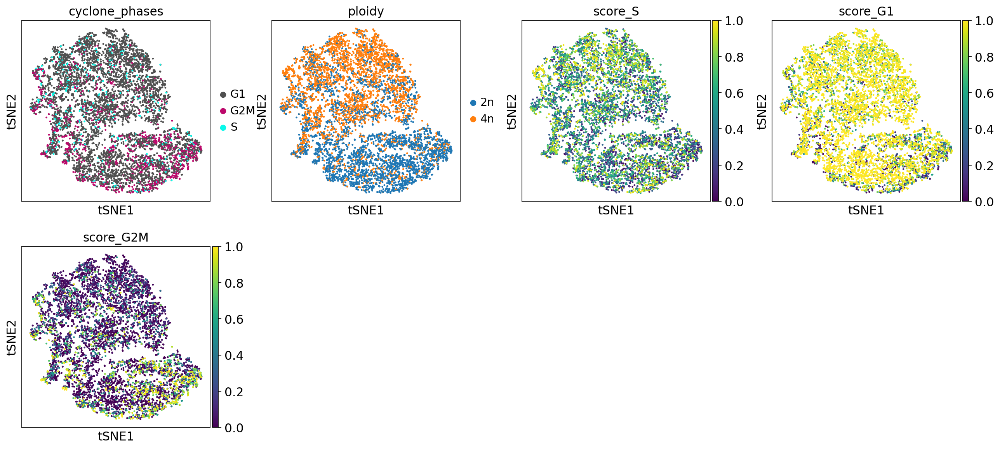

In [20]:
sc.pl.tsne(adata, color=["cyclone_phases","ploidy", "score_S", "score_G1", "score_G2M"])

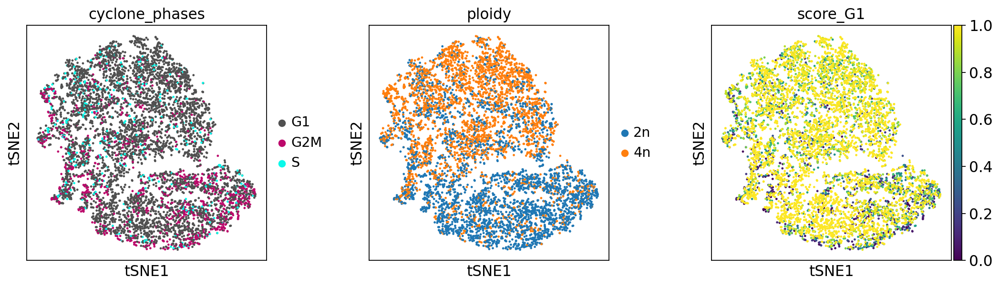

In [21]:
sc.pl.tsne(adata, color=["cyclone_phases","ploidy", "score_G1"], wspace=0.3, save='_cell_cycle.pdf')

In [22]:
adata

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cyclone_phases_colors', 'exp._colors', 'neighbors', 'pca', 'ploidy_colors', 'strain_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'connectivities', 'distances'

In [23]:
adata.write(data_dir + 'snRNAseq_mouse_hepatocytes_all_cells_filtered_TPM_mar21.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [15]:
adata = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_all_cells_filtered_TPM_mar21.h5ad')

Get the cell numbers per cell cycle stage.

In [24]:
meta_info = adata.obs[['age_grouped', 'clusters', 'strain', 'cyclone_phases']]
meta_info['cell_count'] = 'cell_count'

KeyError: "['clusters'] not in index"

In [52]:
tmp = meta_info.groupby(['age_grouped', 'clusters', 
                         'cyclone_phases', 'strain','cell_count'])['age_grouped'].count().unstack()

In [53]:

tmp = tmp.rename(columns=str).reset_index()

In [58]:
tmp.to_csv('./../data/cyclone_phase_total_count.csv')

When computing the proportions, we have to take into account that plates SNI-667 contains only 2n nuclei, while the rest is sorted 50:50 2n:4n.

In [59]:
tmp2 = tmp.groupby(['age_grouped', 'strain']).transform(lambda x: x *100/ x.sum())

In [60]:
tmp2[['age_grouped', 'clusters', 'cyclone_phases', 'strain']] = tmp[['age_grouped', 'clusters', 'cyclone_phases', 'strain',]]

In [62]:
tmp2.to_csv('./../data/cyclone_phase_total_proportions_separate_annotation.csv')

# Cell type identification

## Young mice only

In [16]:
adata

AnnData object with n_obs × n_vars = 6605 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cyclone_phases_colors', 'exp._colors', 'neighbors', 'pca', 'ploidy_colors', 'strain_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'connectivities', 'distances'

In [24]:
adata_young = adata[adata.obs['age_grouped']=='young'].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Select only wild type cells.

In [25]:
adata_young = adata_young[adata_young.obs['strain']=='C57Bl6/J']

In [26]:
adata_young.obs['prelim_anno'] = adata_prev.obs['cell_type1']

Trying to set attribute `.obs` of view, copying.


In [27]:
sc.pp.pca(adata_young, svd_solver='arpack')
sc.pp.neighbors(adata_young)

In [28]:
sc.tl.tsne(adata_young, perplexity=30, n_pcs=15)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


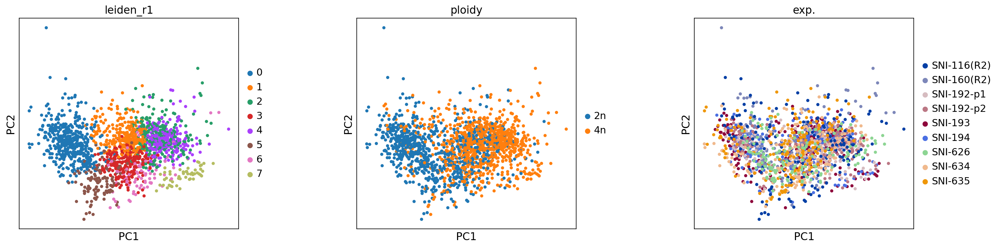

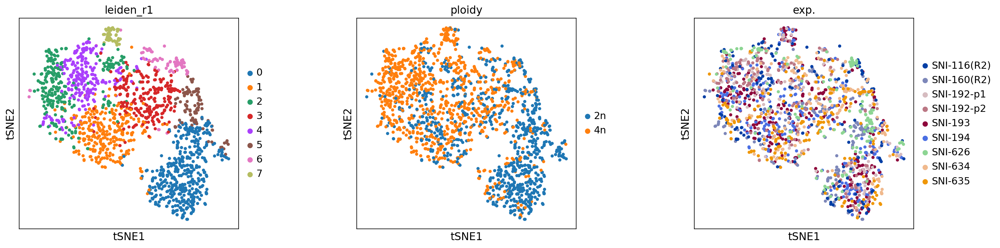

In [29]:
rcParams['figure.figsize']=(5,5)
sc.tl.leiden(adata_young, resolution=1, key_added='leiden_r1')
sc.pl.pca(adata_young, wspace=0.4, color=["leiden_r1", "ploidy","exp."])
sc.pl.tsne(adata_young, wspace=0.4, color=["leiden_r1", "ploidy","exp."])

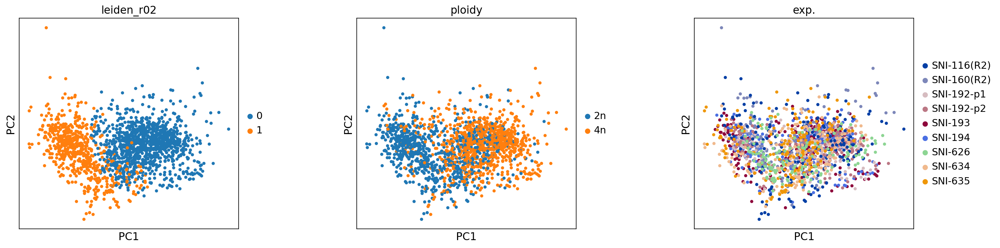

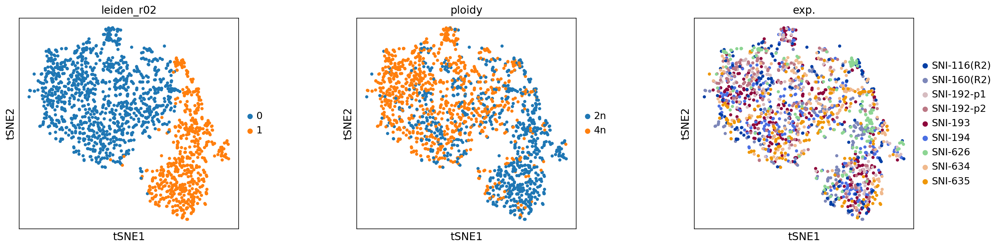

In [30]:
# low resolution louvain clustering to separate hepatocytes from non-parenchymal cells
sc.tl.leiden(adata_young, resolution=0.2, key_added='leiden_r02')
sc.pl.pca(adata_young, wspace=0.4, color=["leiden_r02", "ploidy","exp."])
sc.pl.tsne(adata_young, wspace=0.4, color=["leiden_r02", "ploidy","exp."])

In [31]:
adata_young.obs['low_res_ct'] = adata_young.obs['leiden_r02']

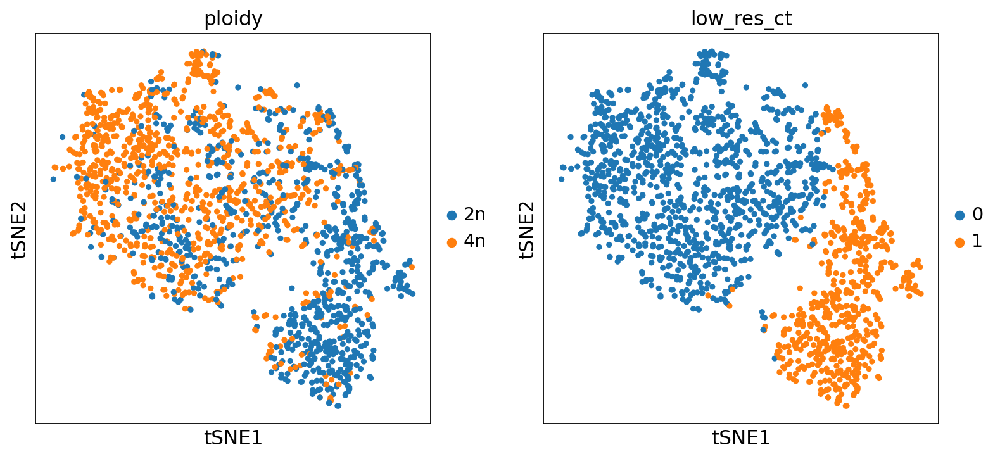

In [32]:
sc.pl.tsne(adata_young, color=["ploidy","low_res_ct"])

Label 4n cells that are in the non-parenchymal cluster.

In [33]:
adata_young.obs['clusters'] = "2-2n"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='0', 
                                         adata_young.obs['ploidy']=='2n')] = "2n_hepatocytes"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='0', 
                                         adata_young.obs['ploidy']=='4n')] = "4n_hepatocytes"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='1', 
                                         adata_young.obs['ploidy']=='2n')] = "2n_other_cluster"
adata_young.obs['clusters'].loc[np.logical_and(adata_young.obs['low_res_ct']=='1', 
                                         adata_young.obs['ploidy']=='4n')] = "4n_other_cluster"
adata_young.obs['clusters'] = adata_young.obs['clusters'].astype('category')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [34]:
adata_young.obs['clusters'].value_counts()

4n_hepatocytes      795
2n_other_cluster    504
2n_hepatocytes      336
4n_other_cluster     98
Name: clusters, dtype: int64

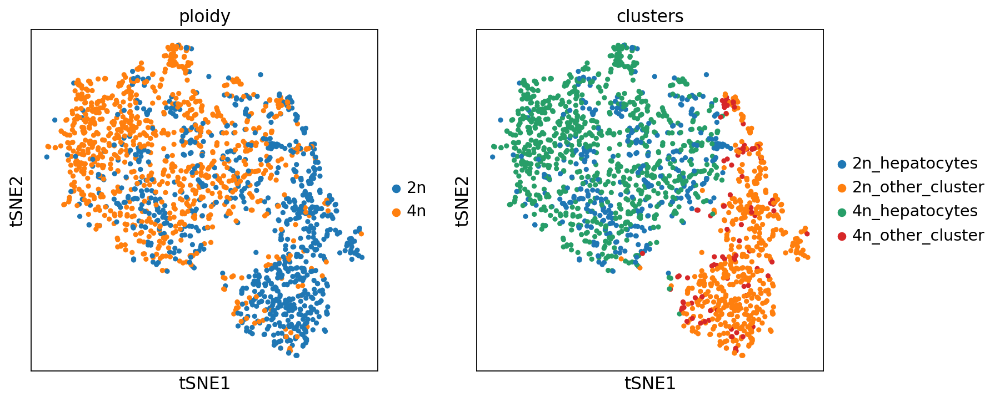

In [35]:
sc.pl.tsne(adata_young, color=['ploidy', 'clusters'])

In [ ]:
#plot gene expression for all cell types
#for key in cell_type_id_dict.keys():
#    print("Save " + key + " genes.")
#    tmp_id = cell_type_id_dict[key]
#    tmp_name = cell_type_name_dict[key]
#    for names in enumerate(tmp_name):
#        tmp_sub_id = tmp_id[names[0]]
#        tmp_sub_name = names[1]
#        sc.pl.tsne(adata_young, color=tmp_sub_id, title=tmp_sub_name, 
#                   use_raw=True, color_map=mymap, show=False,
#                   save = '_' + today +'_young_' + key + '_' + tmp_sub_name + '.pdf')

Compute a gene set score for every gene set.

In [36]:
for key in cell_type_id_dict.keys():
    sc.tl.score_genes(adata_young, cell_type_id_dict[key], score_name='score_' + key, use_raw=True)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


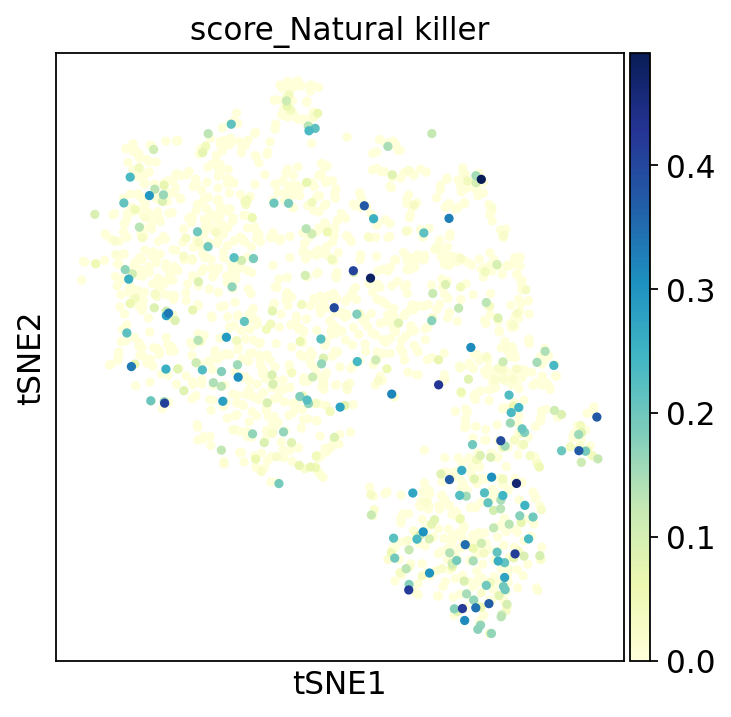

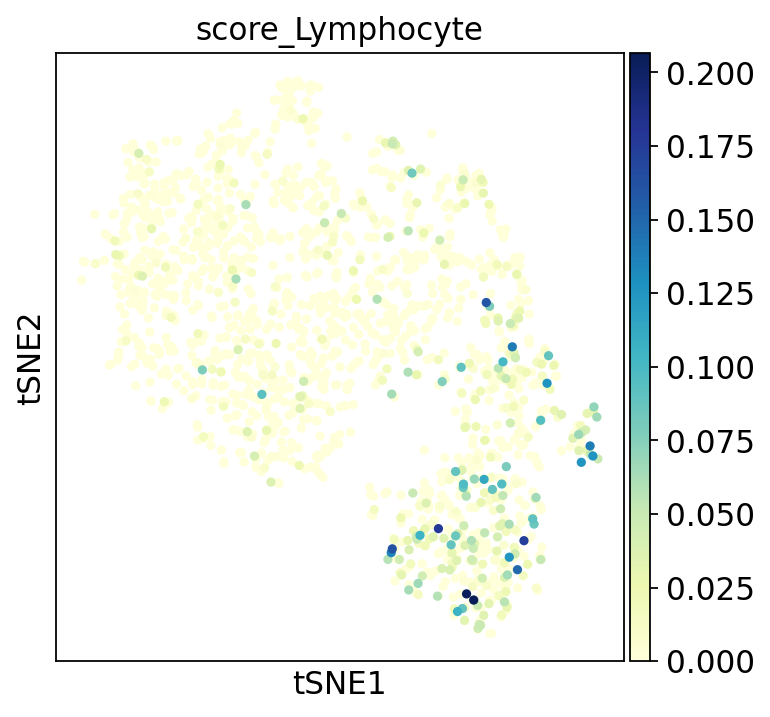

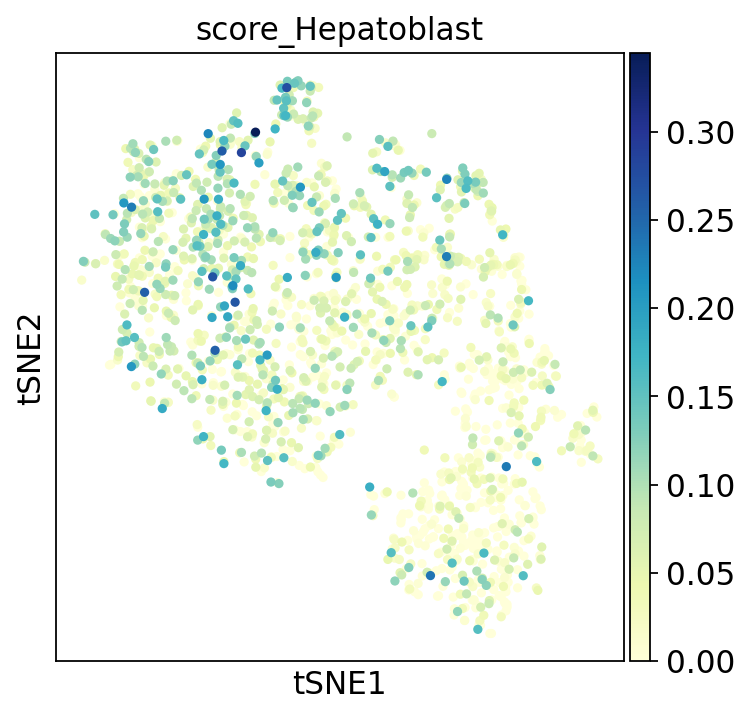

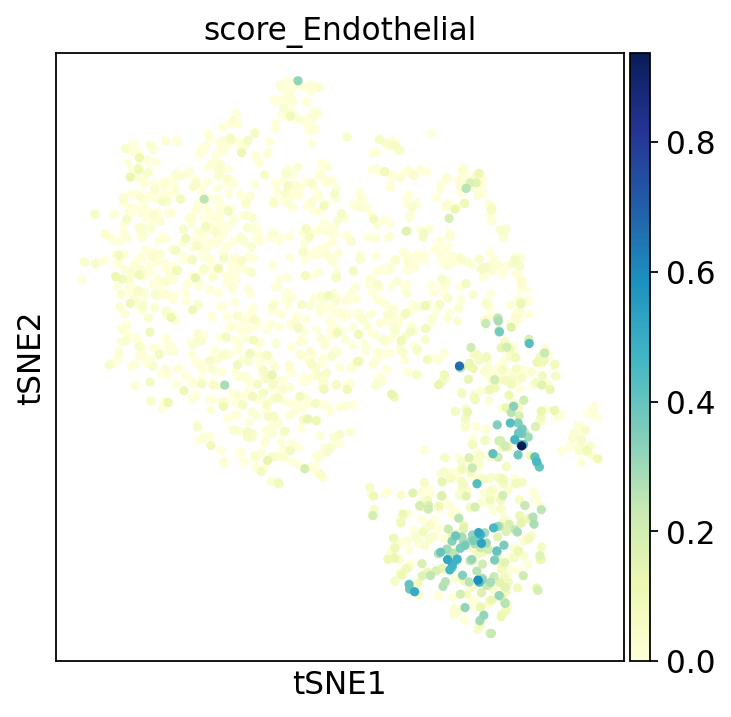

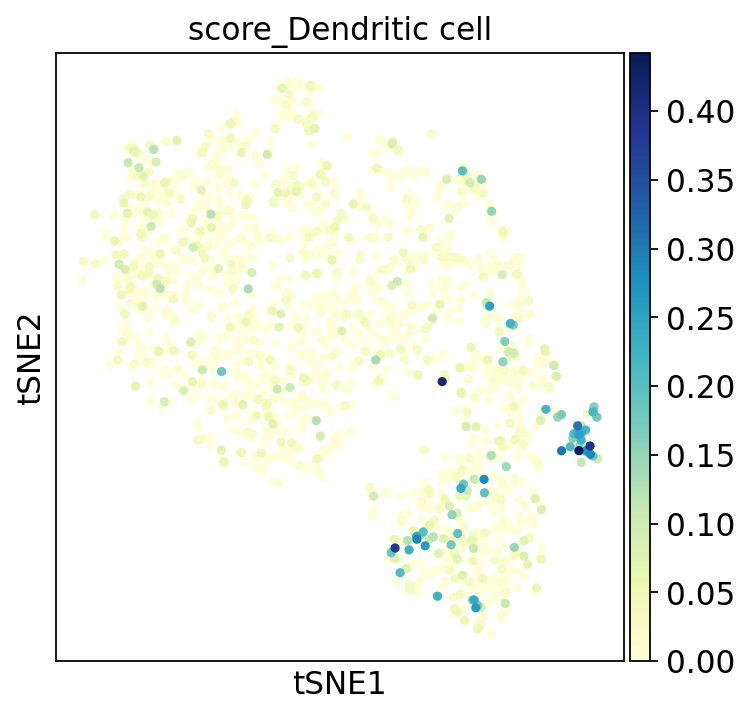

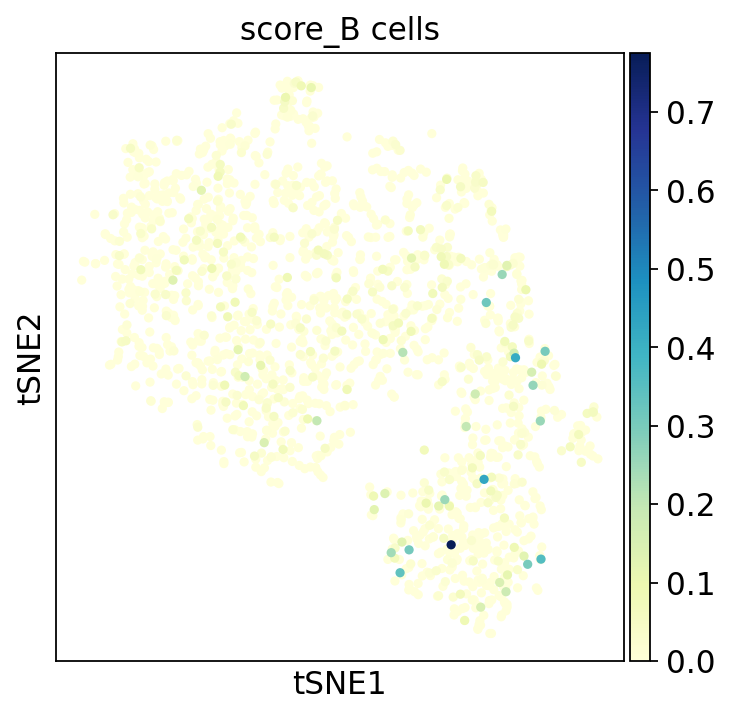

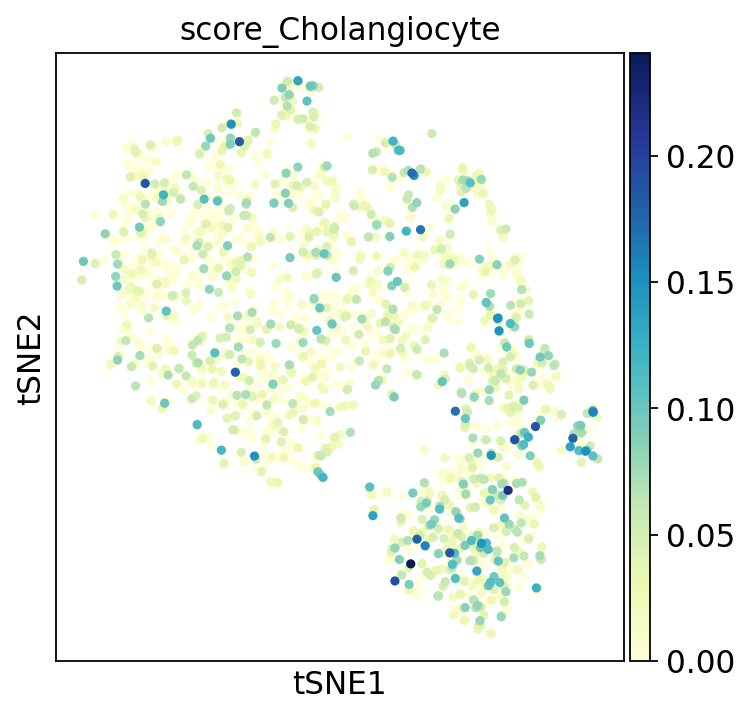

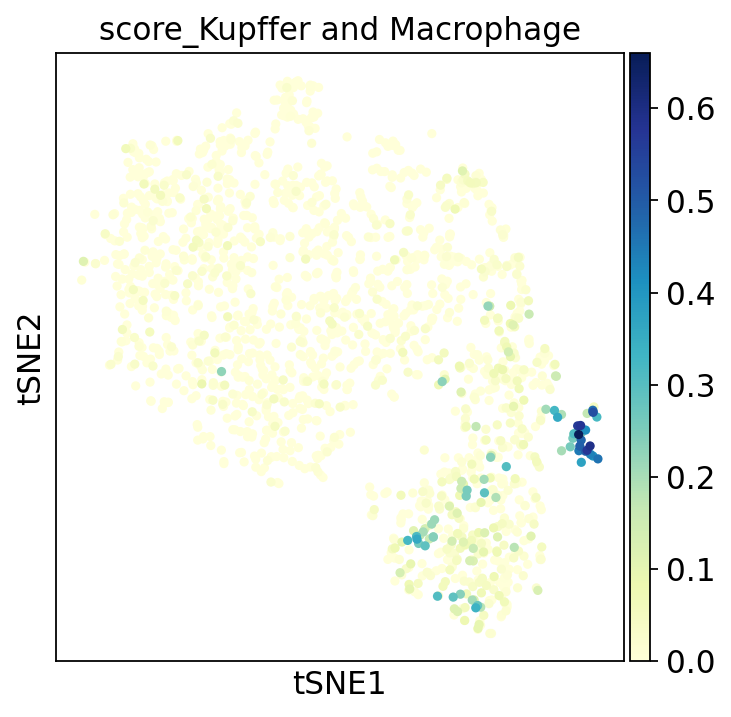

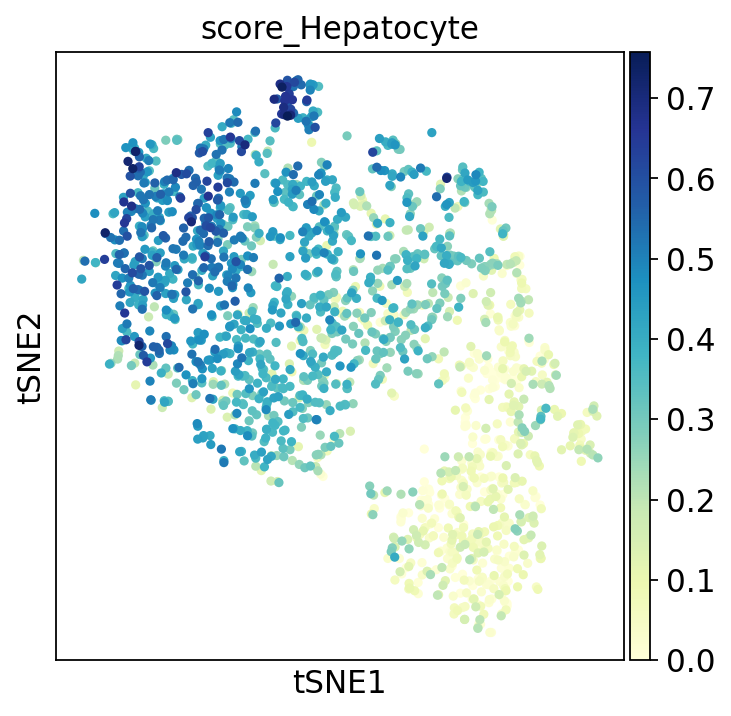

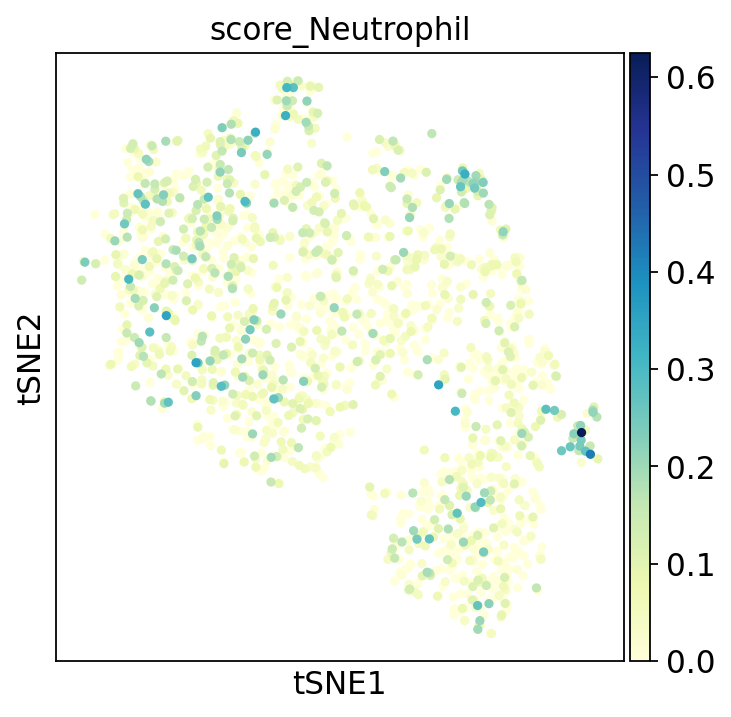

In [37]:
rcParams['figure.figsize']=(5,5)
for key in cell_type_id_dict.keys():
    sc.pl.tsne(adata_young, color='score_' + key, cmap='YlGnBu', vmin=0)

Plot `Reln` and `Bach2` as Stellate Cell and T/B-cell marker, respectively.

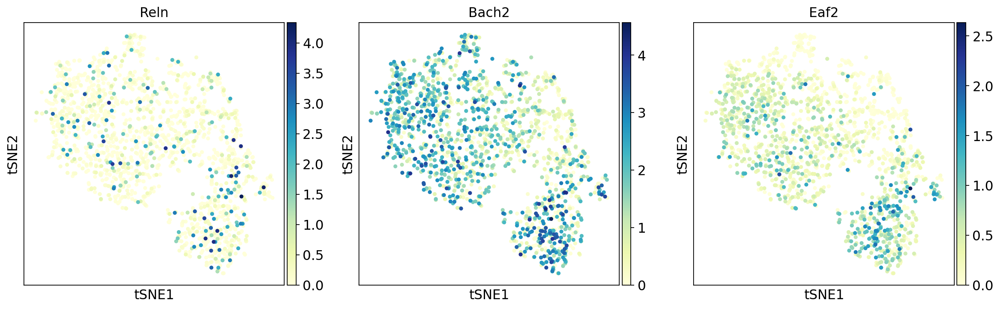

In [38]:
sc.pl.tsne(adata_young, gene_symbols='gene_name', color=['Reln', 'Bach2', 'Eaf2'], cmap='YlGnBu')

In [45]:
adata_young.var_names[adata_young.var['gene_name']=='Reln']

Index(['ENSMUSG00000042453'], dtype='object')

In [40]:
rcParams['figure.figsize']=(5,5)
# high resolution clustering for the non-parenchymal cells
sc.tl.leiden(adata_young, resolution=2, key_added='leidenr02_02', restrict_to=['leiden_r02', ['1']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['1,0']])
#sc.tl.louvain(adata, resolution=0.5, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0,2']])

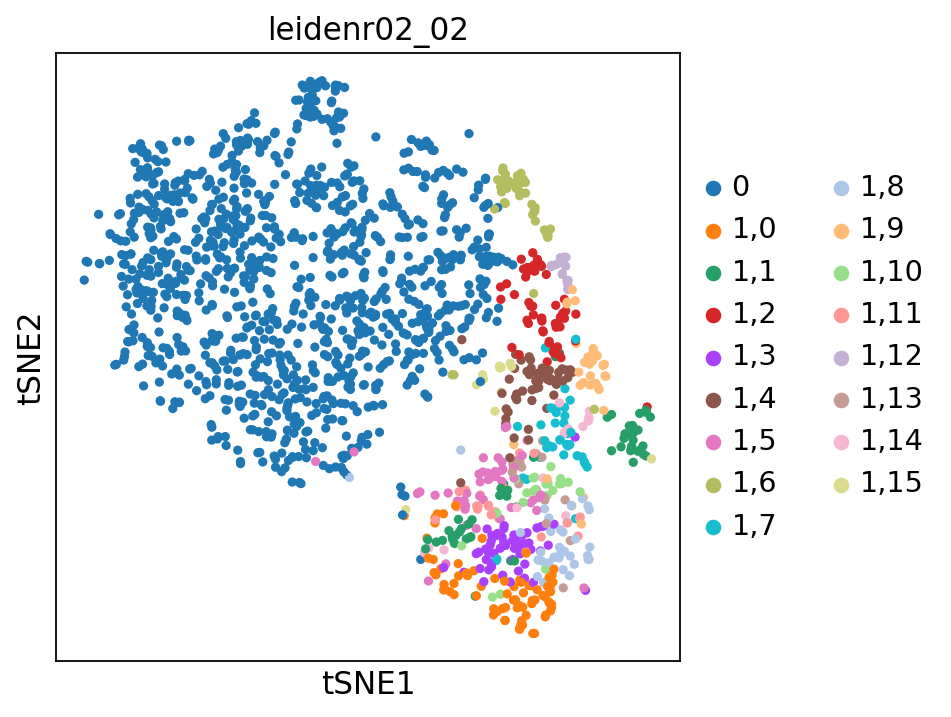

In [41]:
sc.pl.tsne(adata_young, color='leidenr02_02')

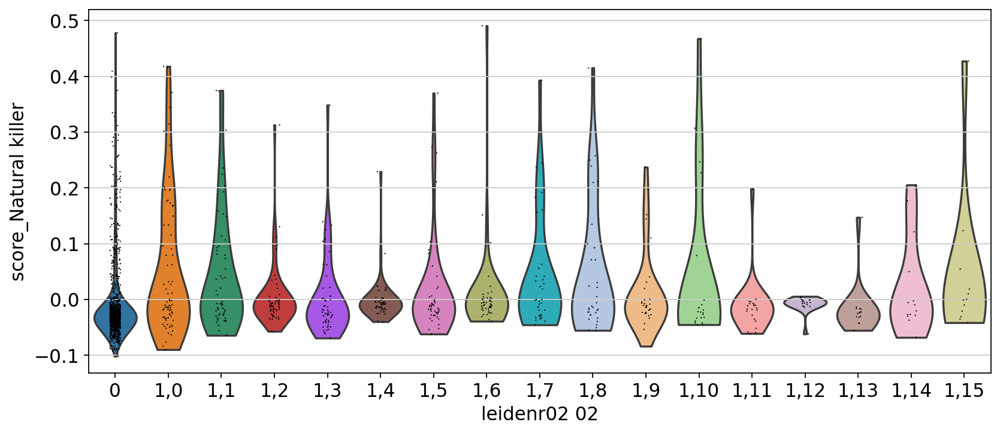

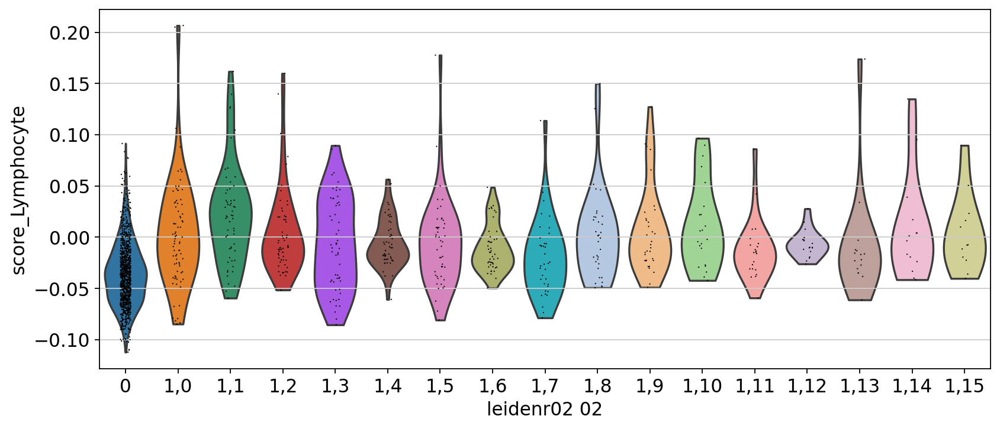

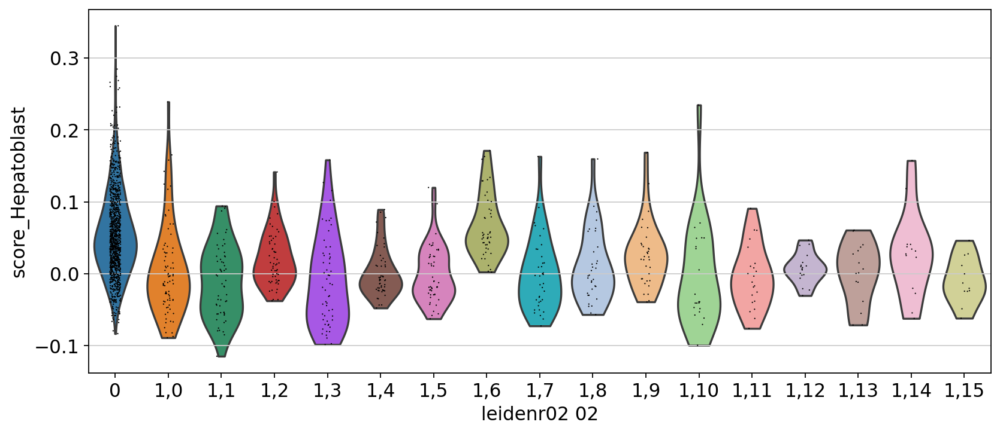

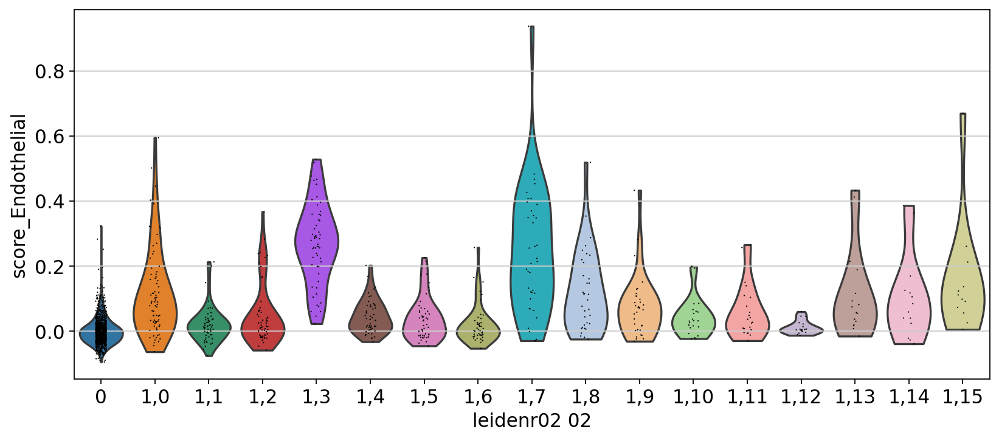

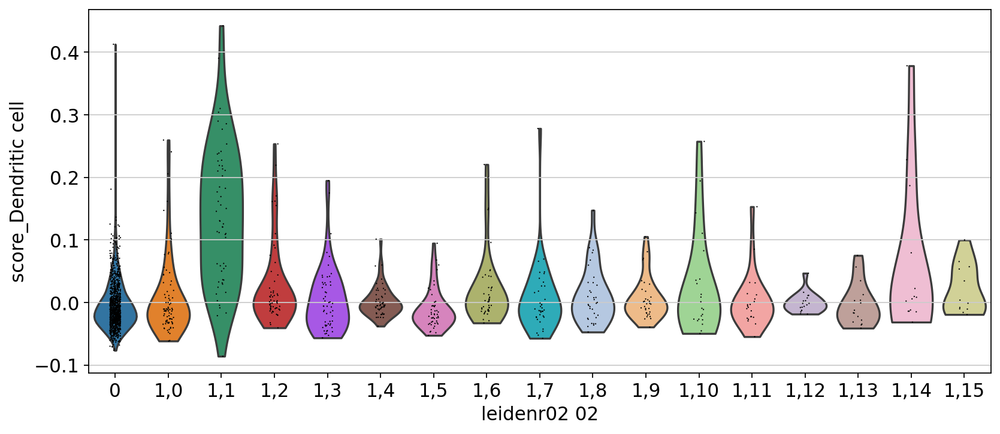

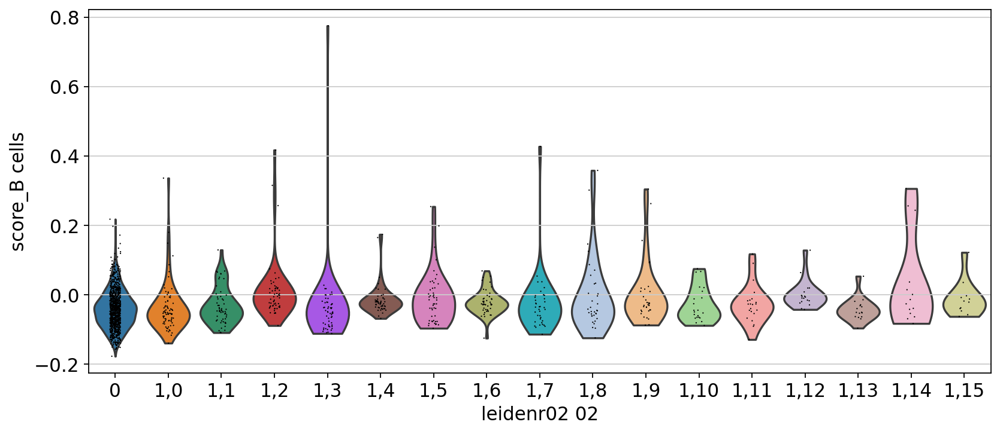

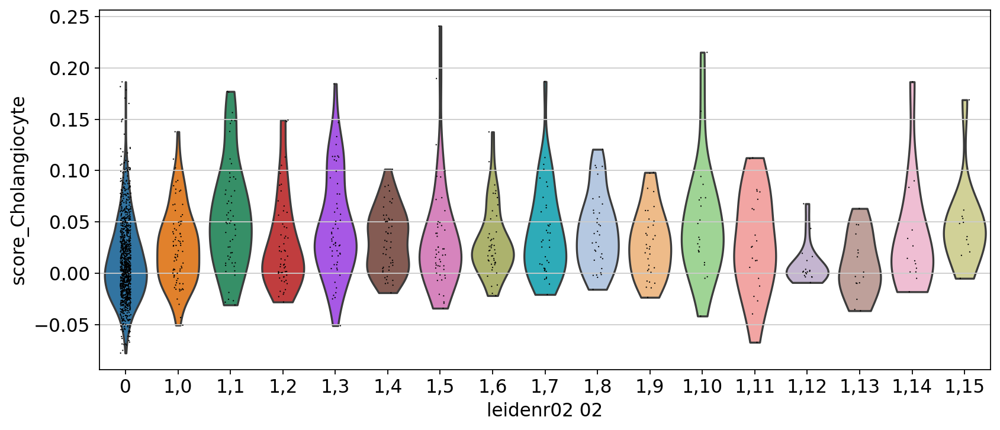

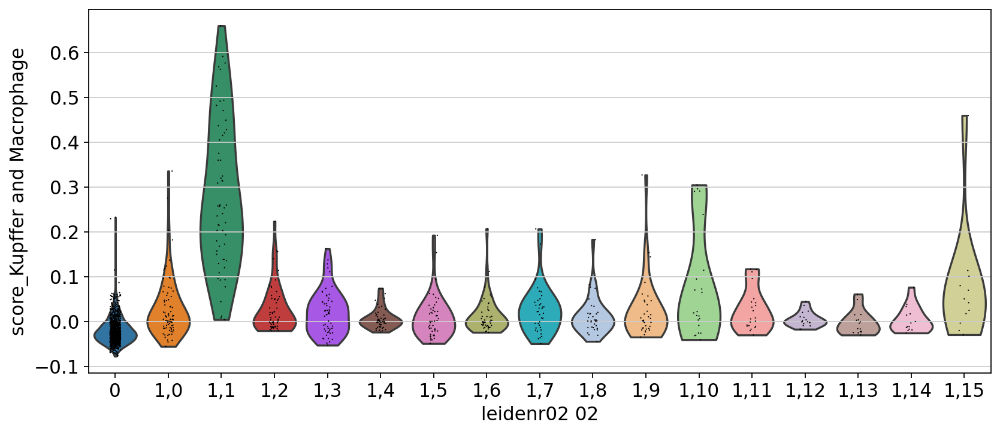

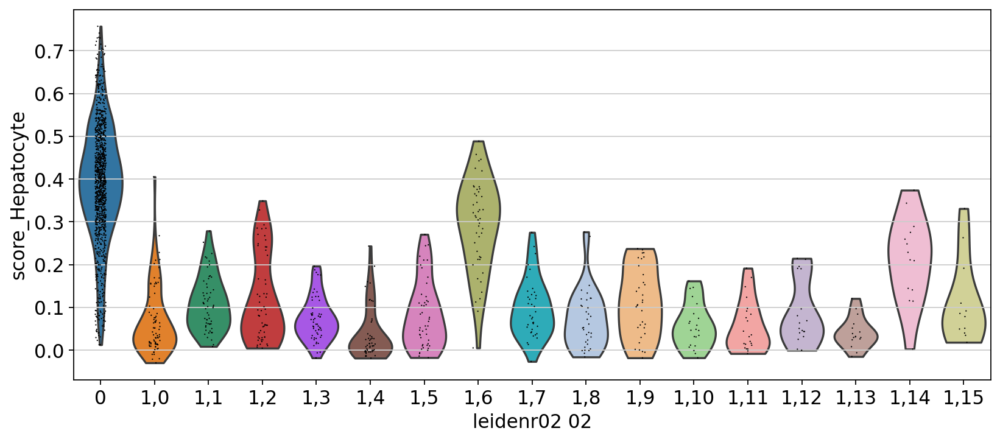

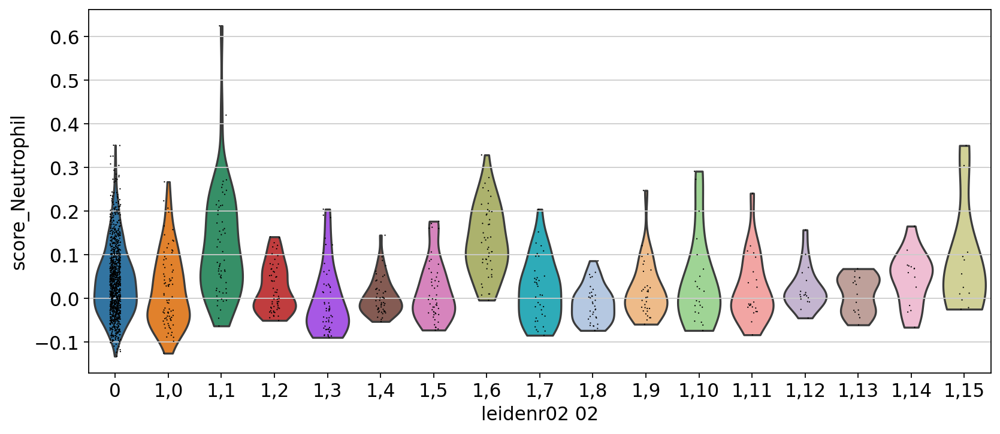

In [43]:
rcParams['figure.figsize']=(10,5)
for key in cell_type_id_dict.keys():
    sc.pl.violin(adata_young, keys='score_' + key, groupby='leidenr02_02')

Make a rough annotation.

In [52]:
adata_young.obs["cell_type"] = adata_young.obs["leidenr02_02"].cat.add_categories(['2n Hepatocytes', 
                                                     '4n Hepatocytes', 
                                                     'Hepatobiliary cells', 
                                                     'Endothelial cells', 
                                                     'Kupffer and Dendritic cells', 'Lymphocytes',
                                                      'Stellate cells'
                                                                       ])



#adata_young.obs["cell_type"].loc[adata_young.obs["score_Natural killer"]>0.2] = 'NK cells'
#adata_young.obs["cell_type"].loc[adata_young.obs["score_Neutrophil"]>0.2] = 'Neutrophils'
#adata_young.obs["cell_type"].loc[adata_young.obs["score_Lymphocyte"]>0] = 'Lymphocytes'


#adata_young.obs["cell_type"].loc[adata_young.obs["score_B cells"]>0.3] = 'B cells'

adata_young.obs["cell_type"].loc[np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,2','1,6', '1,12'])] = 'Hepatobiliary cells'
adata_young.obs["cell_type"].loc[np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,1'])] = 'Kupffer and Dendritic cells'
adata_young.obs["cell_type"].loc[np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,7'])] = 'Stellate cells' #based on Reln expression
adata_young.obs["cell_type"].loc[np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,0','1,4', '1,5', '1,9', '1,10', 
                                          '1,11', '1,13','1,14'])] ='Lymphocytes'# 'Plasma B-cells', 'B cells', 'T cells'
adata_young.obs["cell_type"].loc[np.in1d(adata_young.obs["leidenr02_02"], 
                                         ['1,3','1,8', '1,15'])] = 'Endothelial cells'

adata_young.obs["cell_type"][adata_young.obs["clusters"]=='2n_hepatocytes'] = '2n Hepatocytes'
adata_young.obs["cell_type"][adata_young.obs["clusters"]=='4n_hepatocytes'] = '4n Hepatocytes'

adata_young.obs['cell_type'] = adata_young.obs['cell_type'].cat.remove_unused_categories() 


In [44]:
cell_compo_table(adata_young, "prelim_anno", "leidenr02_02")

prelim_anno,Hepatocytes,Hepatobiliary cells,Endothelial cells,Kupffer and Dendritic cells,Stellate cells,Plasma B-cells,B cells,T cells,All
leidenr02_02,,,,,,,,,
0,1090,30,0,0,2,1,1,0,1124
"1,0",0,0,10,0,0,2,0,67,79
"1,1",0,0,0,47,5,5,0,0,57
"1,2",0,15,0,0,34,0,0,0,49
"1,3",0,0,49,1,0,2,3,1,56
"1,4",0,1,3,0,0,0,46,0,50
"1,5",0,0,10,0,0,36,1,1,48
"1,6",1,42,0,0,0,0,0,0,43
"1,7",0,0,32,0,1,3,0,0,36


In [53]:
adata_young.obs['cell_type'].value_counts()

4n Hepatocytes                 795
2n Hepatocytes                 336
Lymphocytes                    285
Hepatobiliary cells            121
Endothelial cells              102
Kupffer and Dendritic cells     57
Stellate cells                  37
Name: cell_type, dtype: int64

In [54]:
adata_young.obs['cell_type'].value_counts(normalize=True)

4n Hepatocytes                 0.458742
2n Hepatocytes                 0.193883
Lymphocytes                    0.164455
Hepatobiliary cells            0.069821
Endothelial cells              0.058857
Kupffer and Dendritic cells    0.032891
Stellate cells                 0.021350
Name: cell_type, dtype: float64

Set cell type colors.

In [56]:
adata_young.uns["cell_type_colors"] = ["#1f77b4", "#ff7f0e",
                                       #"#332288", "#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

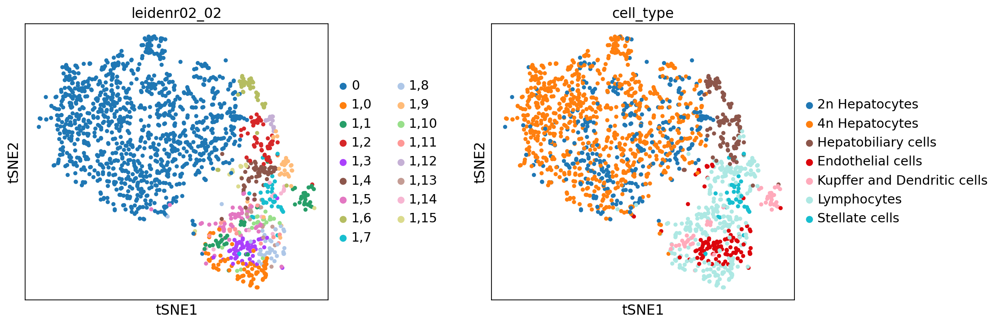

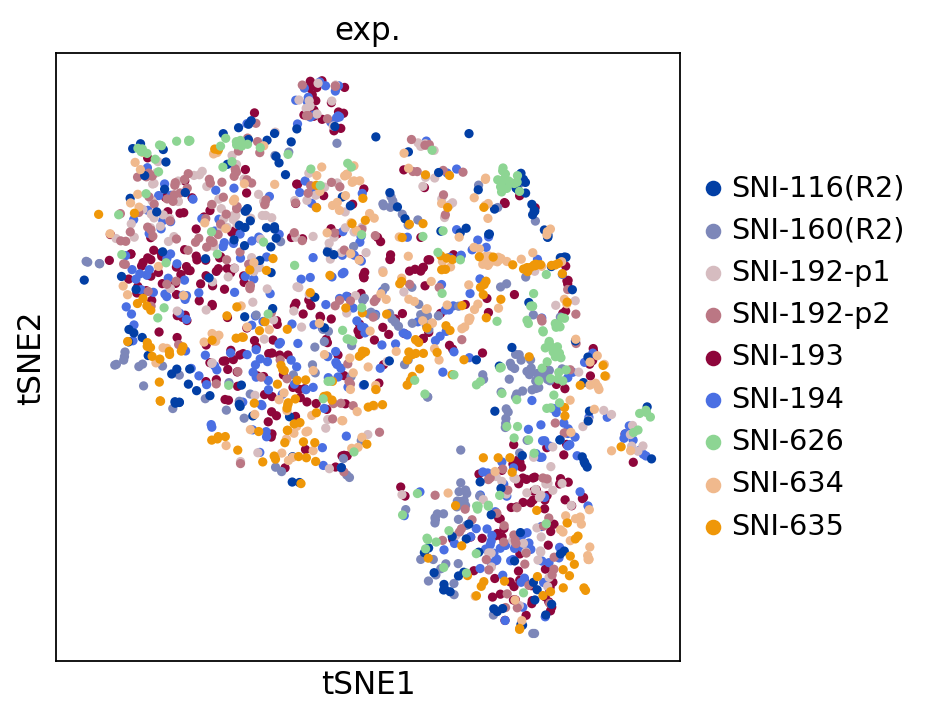

In [57]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_young, wspace=0.4, color=["leidenr02_02", "cell_type"])
sc.pl.tsne(adata_young, color=["exp."], cmap='YlGnBu', vmin=0)

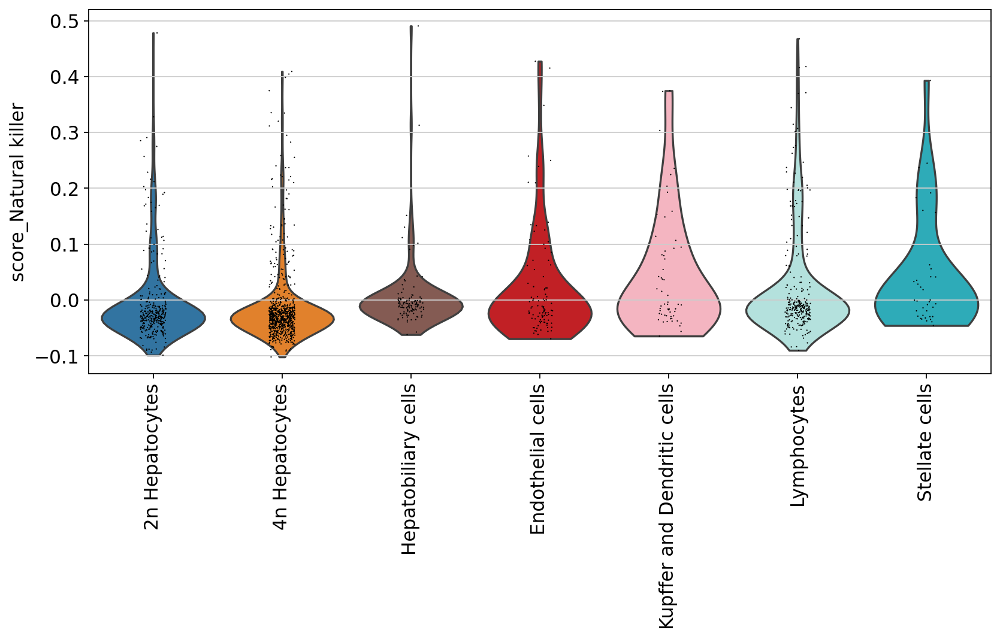

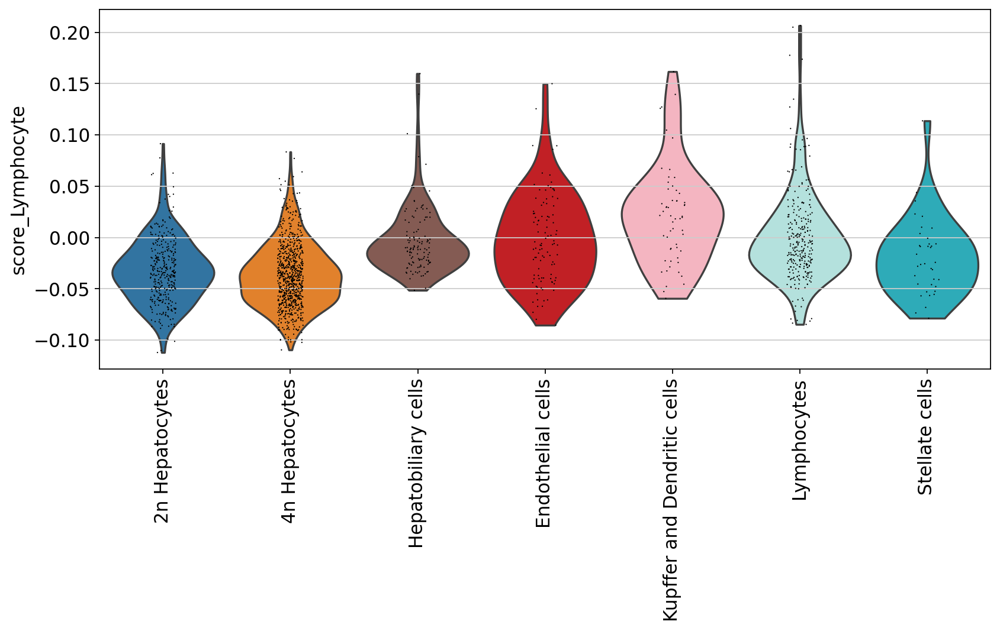

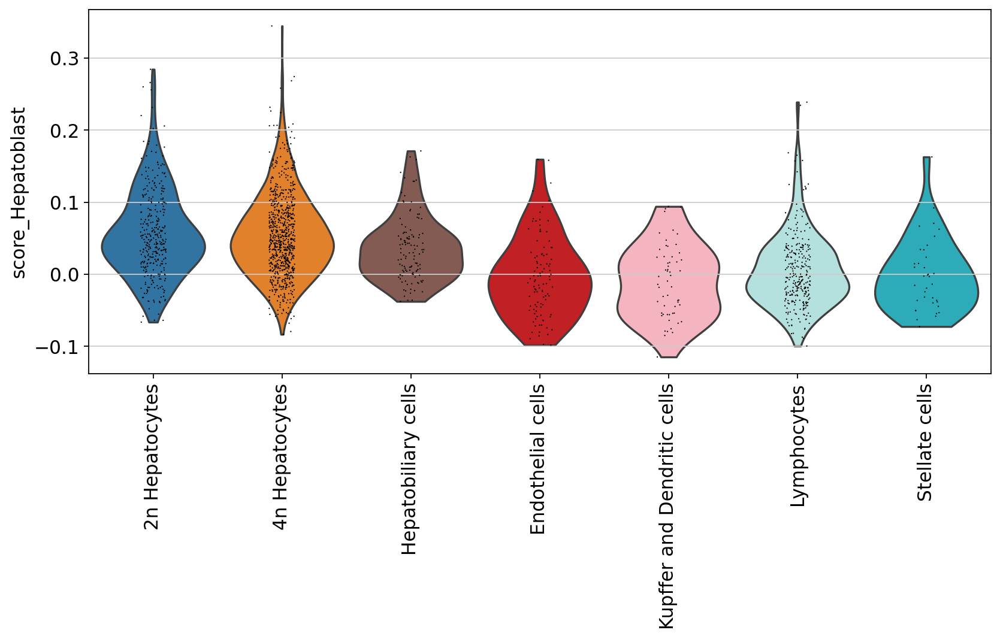

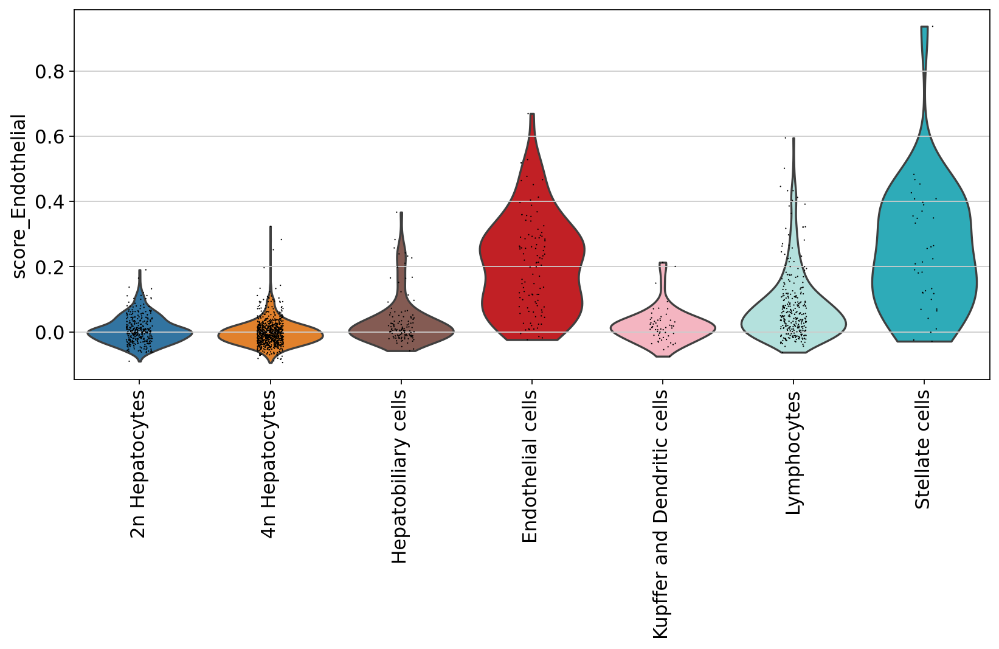

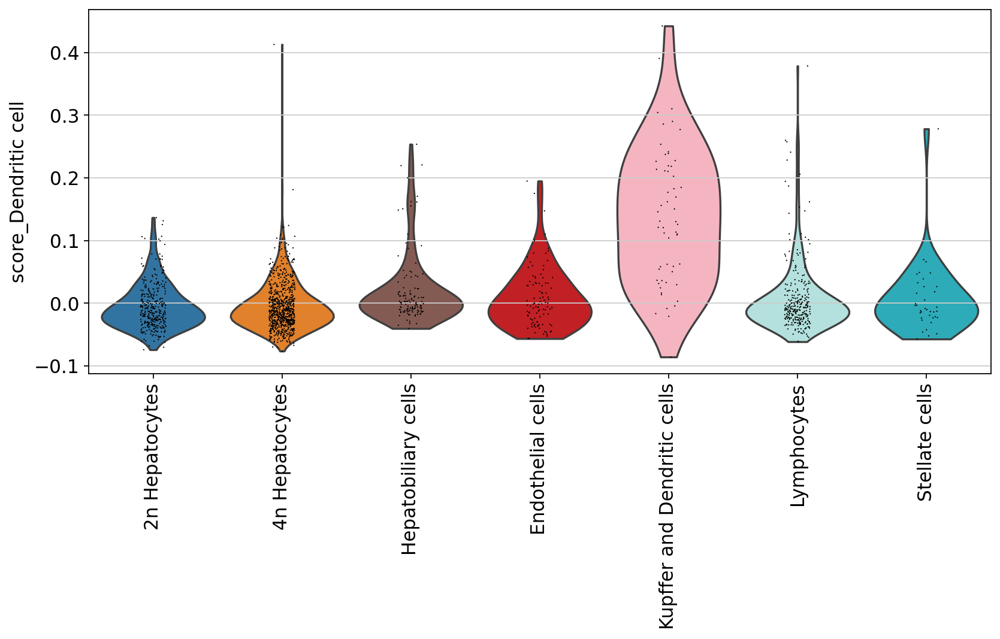

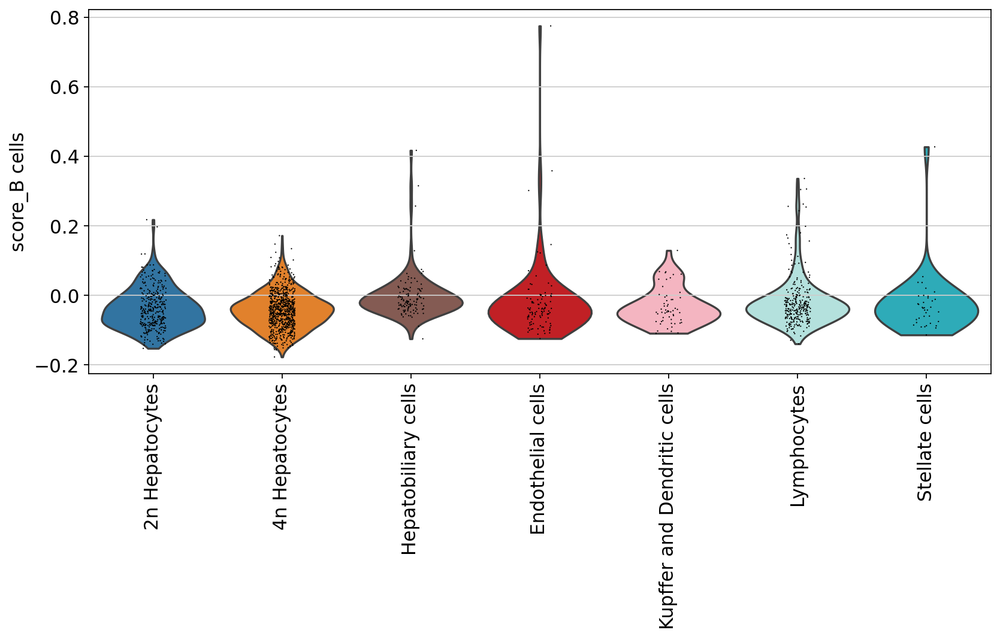

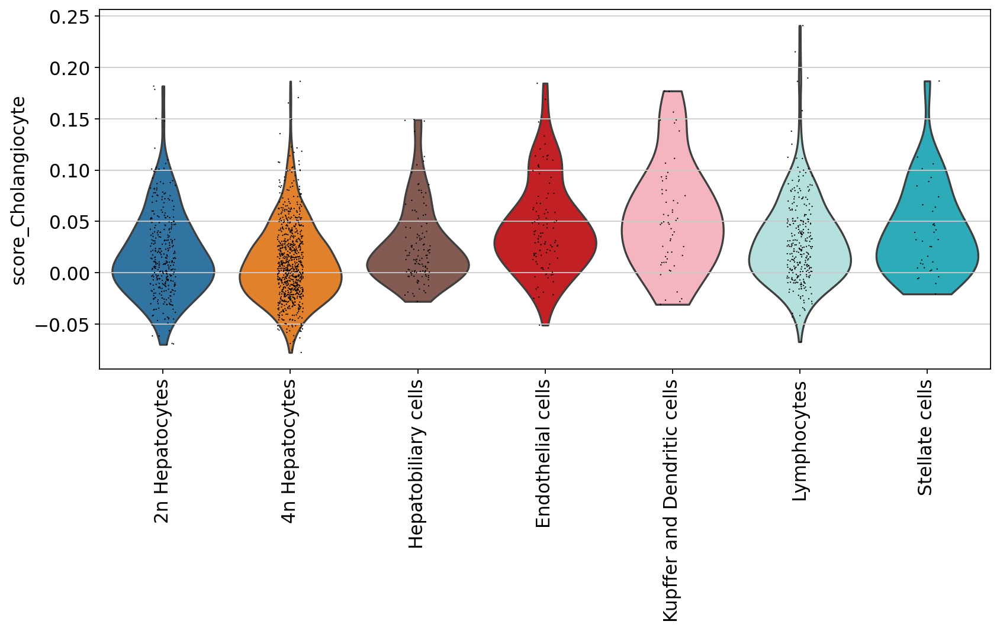

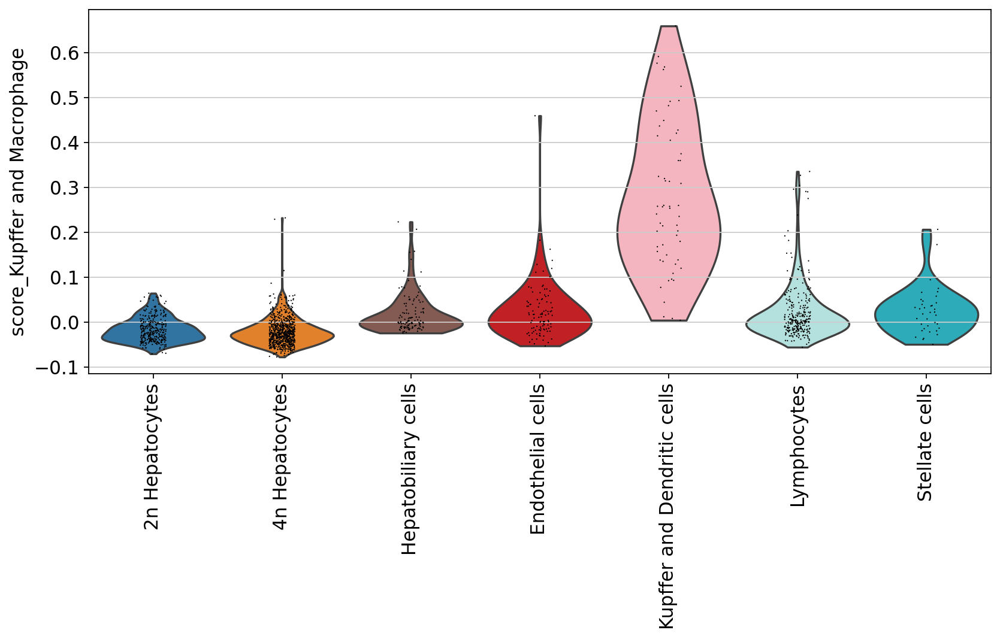

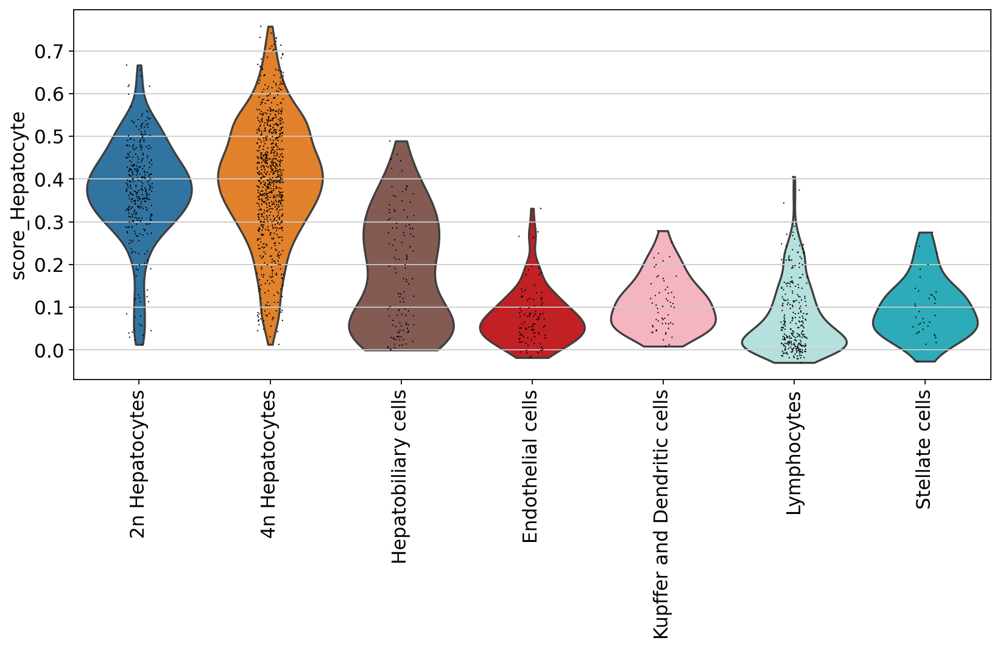

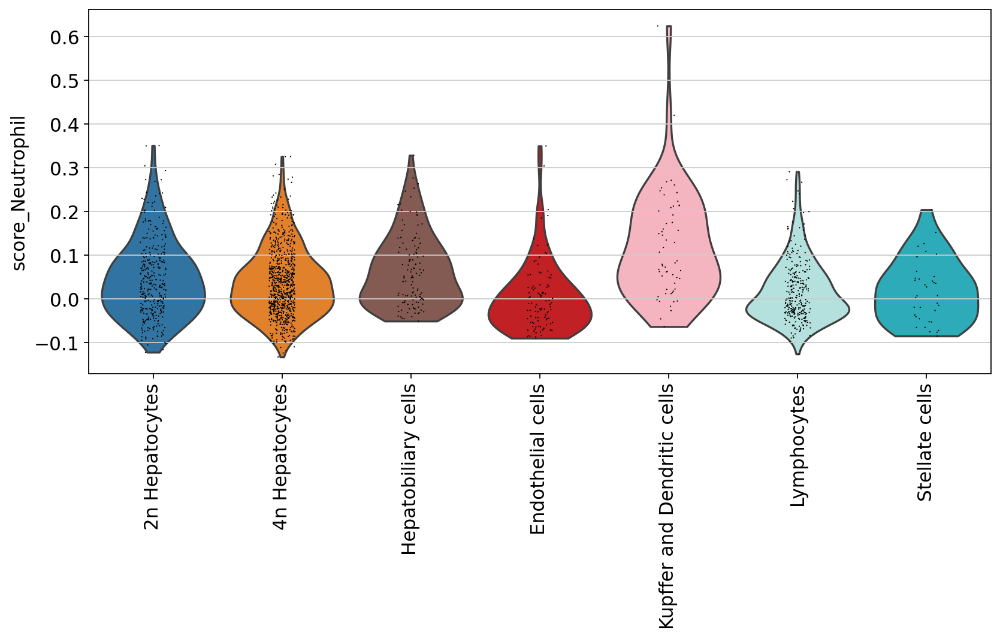

In [58]:
rcParams['figure.figsize']=(10,5)
for key in cell_type_id_dict.keys():
    sc.pl.violin(adata_young, keys='score_' + key, groupby='cell_type', rotation=90)

In [59]:
chol_markers = ['Sptbn1','Sox9','Sox4','Kit','Slc22a3',
                'Hnf1b','Erbb3','Fgfr2','Fgfr3','Sorl1','Wwc1',
                'Cftr','Pkd2','Pkhd1l1','Lrp2','Cdh11','Igfbp5','Wt1','Igfbp6',
                'Wnt2b','Bmp4','Sulf2','Gas1','Gpc3','Vim','Fgf1','Onecut1',
                'Klra2','Ccl5','Pla2g7','Clec12a','Itgal','Folr2','Cybb','Cd38',
                'Epcam','Cdh1']

hepatoblast_markers = ["Ncam1","Cd44","Dlk1","Icam1","Epcam","Cdh1","Onecut3","Afp","Agt","Fgg",
                       "Gsta1","Id3","Lin28b","Etv5","Lgr5","Tbx3","Foxm1","Kit",
                      "Onecut1","Onecut2","Notch2","Tbx3","Hnf1b","Hes1","Foxa2","Foxa3","Hhex",
                       "Sall4","Hnf4a","Alb","Krt19","Epcam","Tacstd2","Anpep","Itga6","Cd133",
                       "Thy1","Fgf7","Sox9","Krt18","Krt19","Cebpa","Serpina16","Mki67","Krt7",
                       "Tmem45b","Tacstd2","Igdcc4","Itga6","Ptprcap","Atxn1"]

nmarker_name = {}
nmarker_id = []
index = 0
for n in adata.var["gene_name"].tolist():
    if n in hepatoblast_markers:
        nmarker_name[n] = adata_young.var_names[index]
        nmarker_id.append(adata_young.var_names[index])
    index += 1

adatah = adata_young[:,nmarker_id].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [60]:
adata_young.obs["hblast_marker_sum"] = np.sum(adatah.layers["raw"], axis=1)

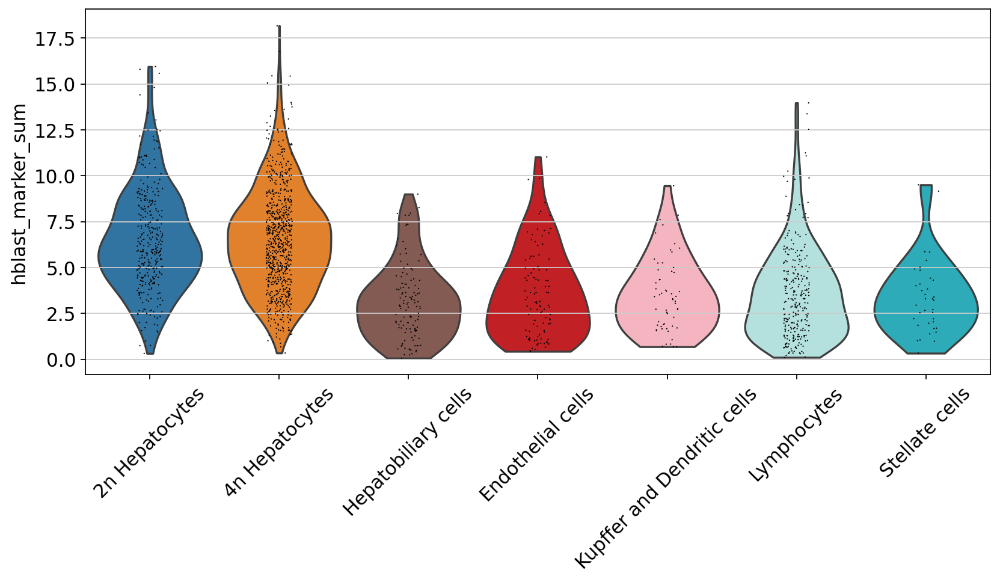

In [61]:
rcParams['figure.figsize']=(10,5)
sc.pl.violin(adata_young, "hblast_marker_sum", groupby="cell_type", rotation=45)

Color the clusters nicely

In [62]:
adata_young.uns["low_res_ct_colors"] = ["#686868", "#a9a9a9"]

Combine the hepatocytes and re-arrange the levels.

In [63]:
adata_young.obs['cell_type1'] = adata_young.obs['cell_type'].cat.add_categories(['Hepatocytes'])
adata_young.obs['cell_type1'][np.in1d(adata_young.obs['cell_type'], 
                                      ["2n Hepatocytes", "4n Hepatocytes"])] = 'Hepatocytes'
adata_young.obs['cell_type1'] = adata_young.obs['cell_type1'].cat.remove_unused_categories()
adata_young.obs['cell_type1'] = adata_young.obs['cell_type1'].cat.reorder_categories(['Hepatocytes', 
                                              'Hepatobiliary cells', 'Endothelial cells', 
                                     "Kupffer and Dendritic cells", 'Lymphocytes','Stellate cells'
                                               
                                                                         ])

In [64]:
adata_young.uns["cell_type1_colors"] = ["#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

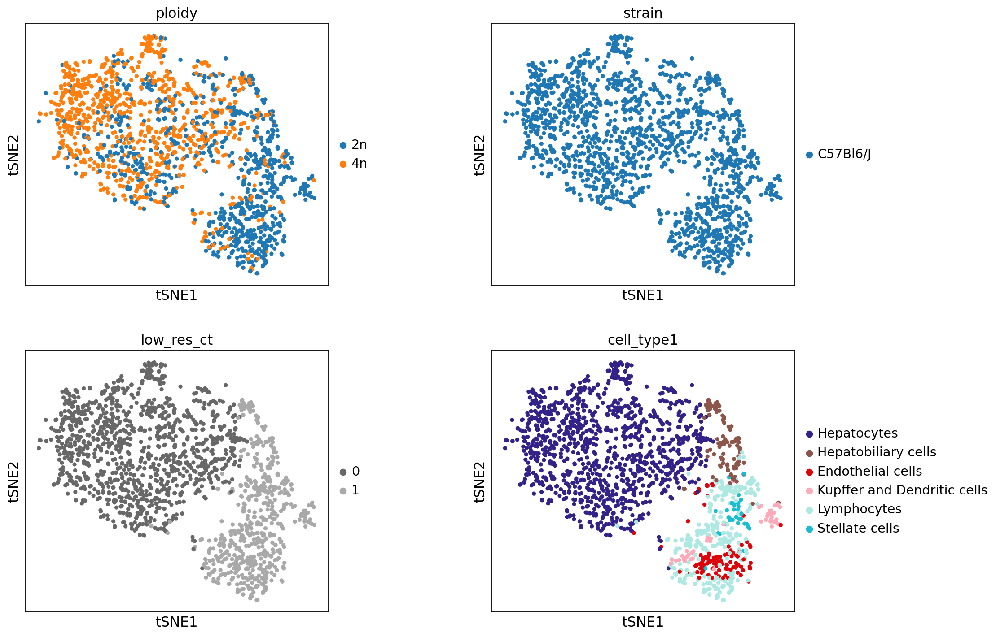

In [65]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_young, color=["ploidy", "strain", "low_res_ct", "cell_type1"],
           ncols=2, wspace=0.4, save="_" + today + "_young_prelim_annotation.pdf")

Save the annotated adata object.

In [66]:
adata_young.write(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [9]:
adata_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')

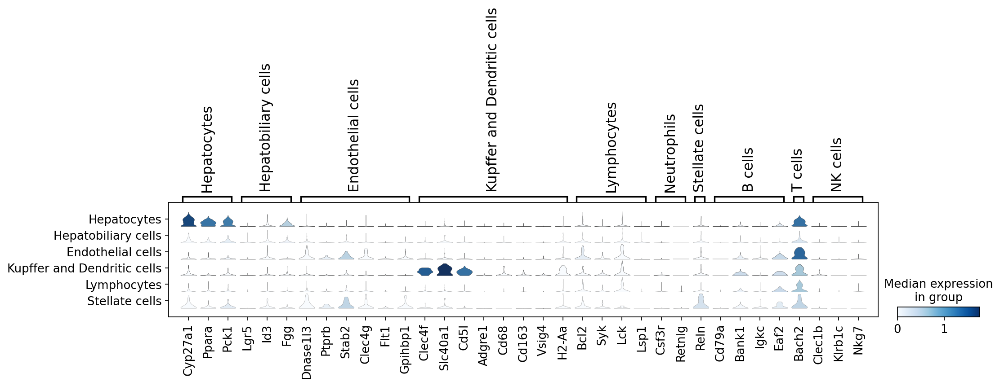

In [10]:
# plotting the markers nicely (using scanpy 1.6)


small_marker_dict = {"Hepatocytes":["Cyp27a1","Ppara","Pck1"],
                    "Hepatobiliary cells":["Lgr5","Id3","Fgg"],
                    "Endothelial cells":["Dnase1l3","Ptprb","Stab2", "Clec4g", "Flt1","Gpihbp1"],
                    "Kupffer and Dendritic cells":["Clec4f","Slc40a1","Cd5l", "Adgre1",  
                                                   "Cd68", "Cd163", "Vsig4", "H2-Aa"],
                    "Lymphocytes":["Bcl2","Syk","Lck", 'Lsp1'],
                     "Neutrophils":["Csf3r", "Retnlg"],
                     'Stellate cells': ['Reln'],
                    "B cells": ["Cd79a", "Bank1", "Igkc", 'Eaf2'],
                     "T cells": ["Bach2"],
                    "NK cells": ["Clec1b", "Klrb1c", "Nkg7"]}

sc.pl.stacked_violin(adata_young, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, save='_'+today+"_young_prelim_annotation_markers.pdf")

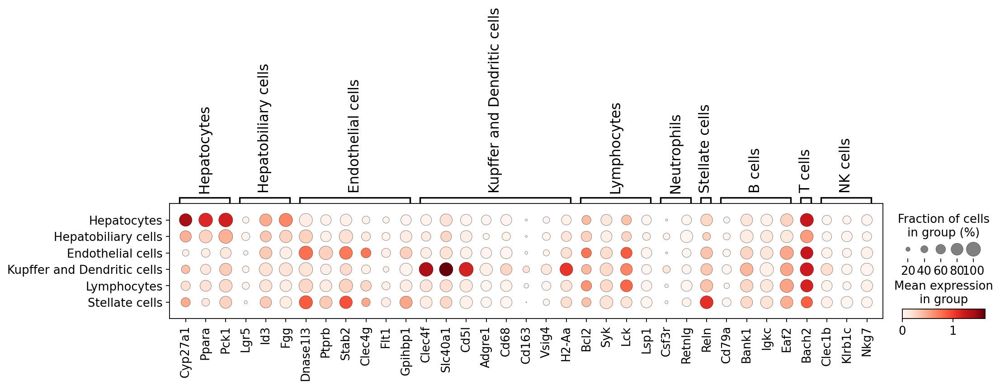

In [11]:
sc.pl.dotplot(adata_young, gene_symbols="gene_name", groupby="cell_type1", 
              var_names=small_marker_dict, use_raw=False, 
              save='_'+today+"_young_prelim_annotation_markers.pdf")   

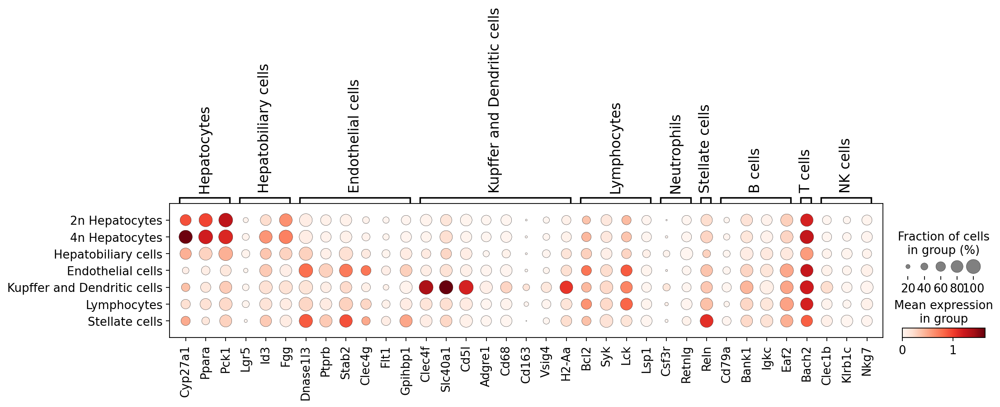

In [12]:
sc.pl.dotplot(adata_young, gene_symbols="gene_name", groupby="cell_type", 
              var_names=small_marker_dict, use_raw=False, 
              save='_'+today+"_young_prelim_annotation_markers2.pdf")   

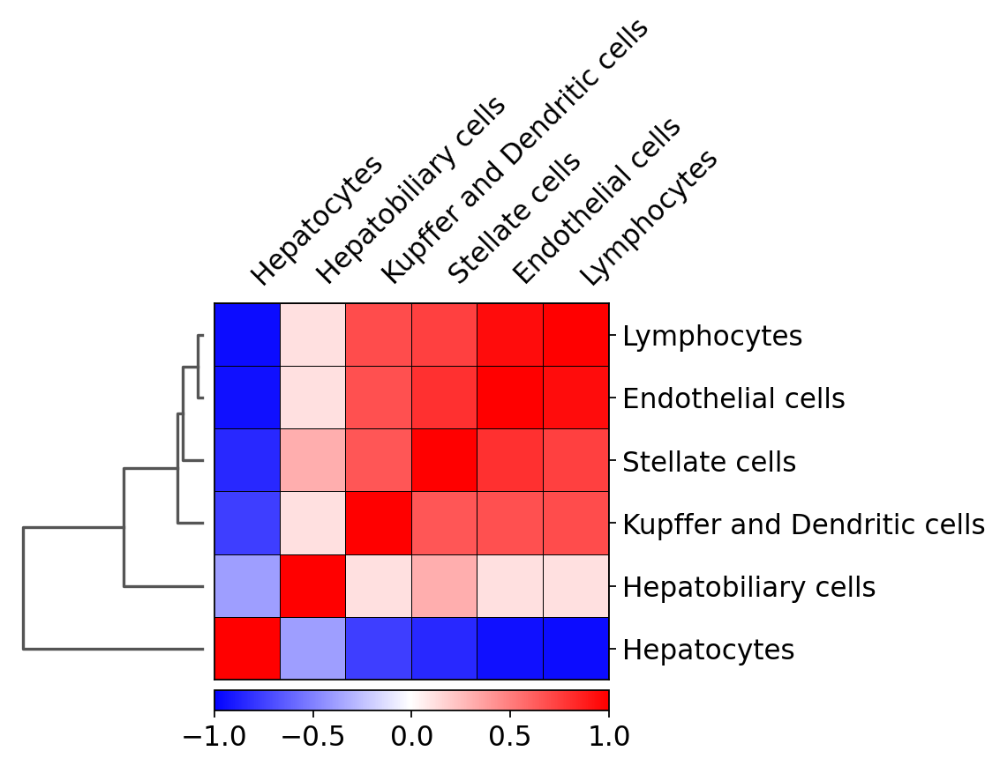

In [13]:
sc.pl.correlation_matrix(adata_young, groupby="cell_type1", save='_' + today + "_young_correlation.pdf")

Change gene names from ENSEMBL ID to gene symbol.

In [73]:
adata_young.var_names = adata_young.var['gene_name'].astype('str')

In [74]:
adata_young.var_names_make_unique()

In [75]:
adata_young

AnnData object with n_obs × n_vars = 1733 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'prelim_anno', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution

In [76]:
del adata_young.layers['counts']
del adata_young.layers['norm_counts']
del adata_young.layers['raw']
del adata_young.layers['raw_bin']

In [77]:
del adata_young.var['gene_name']

Save as cellxgene file.

In [78]:
adata_young.write('./../data/cellxgene_wt_jul21.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [79]:
proportions_young = pd.crosstab(adata_young.obs['cell_type'], 
                                adata_young.obs['strain'], margins=True, normalize=1)*100

In [80]:
proportions_young

strain,C57Bl6/J,All
cell_type,,
2n Hepatocytes,19.388344,19.388344
4n Hepatocytes,45.874207,45.874207
Hepatobiliary cells,6.982112,6.982112
Endothelial cells,5.885747,5.885747
Kupffer and Dendritic cells,3.289094,3.289094
Lymphocytes,16.445470,16.445470
Stellate cells,2.135026,2.135026


In [81]:
proportions_young.to_csv(data_dir + 'cell_counts_young_'+ today + '.csv' )

## Old mice only

In [82]:
adata_prev = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jan21_annotated.h5ad')

In [83]:
adata_prev

AnnData object with n_obs × n_vars = 1127 × 24650
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'Krt14', 'Krt19', 'Krt7', 'Krt9', 'Prom1', 'Dlk1', 'Erbb2', 'Mki67', 'Oct4', 'Cd34', 'Tpm2', 'Ace2', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Natural killer', 'score_Cholangiocyte', 'score_Hepatocyte', 'score_Neutrophil', 'score_Endothelial', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Kupffer and Macrophage', 'score_Dendritic cell', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_cells', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_c

In [84]:
adata_old = adata[adata.obs['age_grouped']=='old'].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Select wild type cells.

In [85]:
adata_old = adata_old[adata_old.obs['strain']=='C57Bl6/J']

In [86]:
adata_old.obs['prelim_anno']= adata_prev.obs['cell_type1']

Trying to set attribute `.obs` of view, copying.


In [87]:
adata_old

AnnData object with n_obs × n_vars = 1175 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'prelim_anno'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cyclone_phases_colors', 'exp._colors', 'neighbors', 'pca', 'ploidy_colors', 'strain_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'norm_counts', 'raw', 'raw_bin'
    obsp: 'connectivities', 'distances'

Recompute embeddings.

In [88]:
sc.pp.pca(adata_old, svd_solver='arpack')
sc.pp.neighbors(adata_old)
sc.tl.tsne(adata_old, perplexity=30, n_pcs=15)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


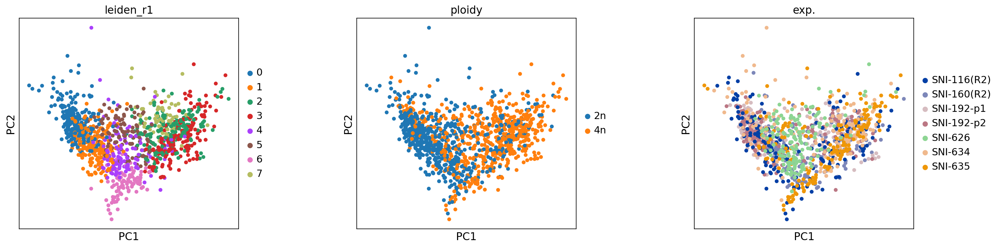

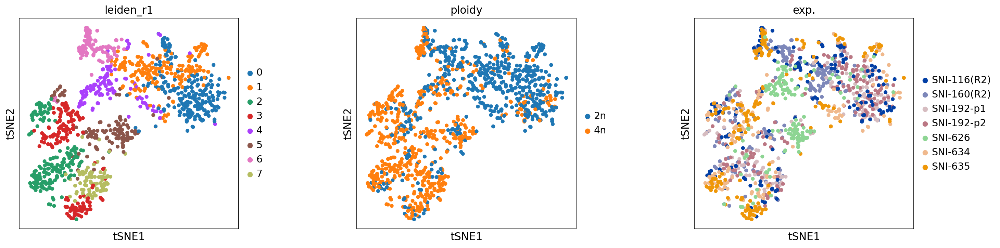

In [89]:
sc.tl.leiden(adata_old, resolution=1, key_added='leiden_r1')
rcParams['figure.figsize']=(5,5)
sc.pl.pca(adata_old, wspace=0.4, color=["leiden_r1", "ploidy","exp."])
sc.pl.tsne(adata_old, wspace=0.4, color=["leiden_r1", "ploidy","exp."])

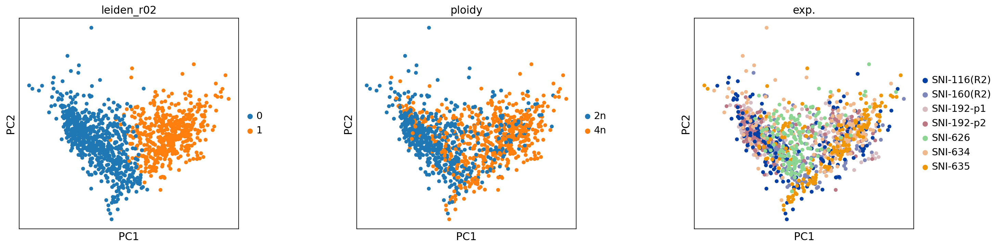

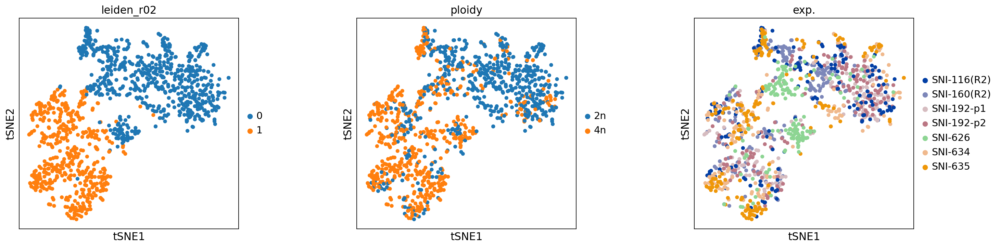

In [90]:
# low resolution louvain clustering to separate hepatocytes from non-parenchymal cells
sc.tl.leiden(adata_old, resolution=0.2, key_added='leiden_r02')
sc.pl.pca(adata_old, wspace=0.4, color=["leiden_r02", "ploidy","exp."])
sc.pl.tsne(adata_old, wspace=0.4, color=["leiden_r02", "ploidy","exp."])

In [91]:
adata_old.obs['low_res_ct'] = adata_old.obs['leiden_r02']

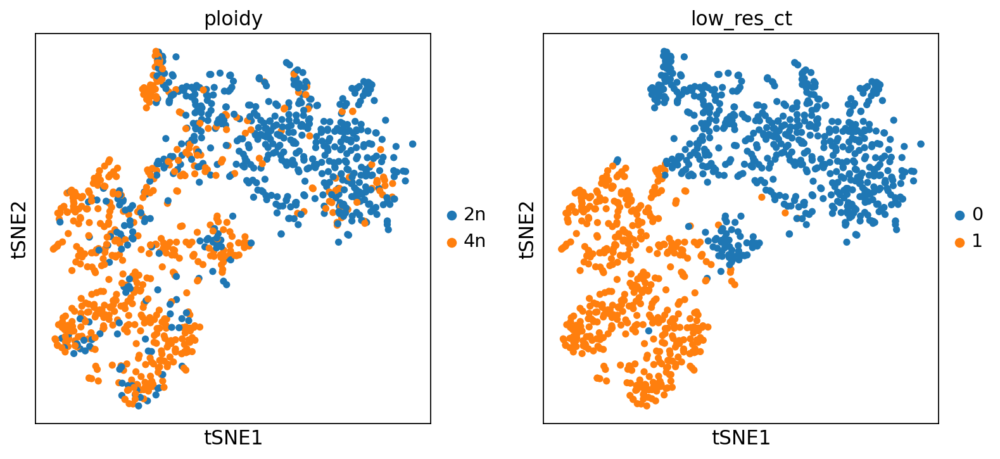

In [92]:
sc.pl.tsne(adata_old, color=["ploidy","low_res_ct"])

Label 4n cells that are in the non-parenchymal cluster.

In [93]:
adata_old.obs['clusters'] = "2-2n"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='1', 
                                             adata_old.obs['ploidy']=='2n')] = "2n_hepatocytes"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='1', 
                                             adata_old.obs['ploidy']=='4n')] = "4n_hepatocytes"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='0', 
                                             adata_old.obs['ploidy']=='2n')] = "2n_other_cluster"
adata_old.obs['clusters'].loc[np.logical_and(adata_old.obs['low_res_ct']=='0', 
                                             adata_old.obs['ploidy']=='4n')] = "4n_other_cluster"
adata_old.obs['clusters'] = adata_old.obs['clusters'].astype('category')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [94]:
adata_old.obs['clusters'].value_counts()

2n_other_cluster    497
4n_hepatocytes      410
4n_other_cluster    167
2n_hepatocytes      101
Name: clusters, dtype: int64

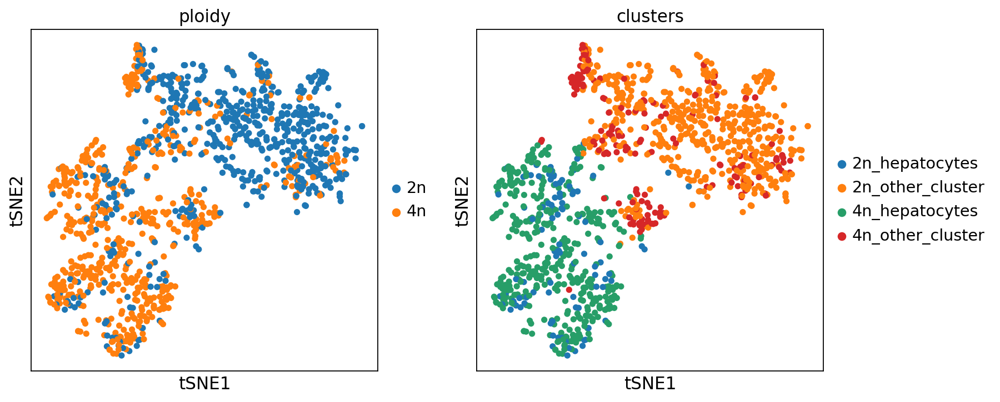

In [95]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, color=['ploidy', 'clusters'])

In [52]:
# Endothelial cells
#for key in cell_type_id_dict.keys():
#    print("Save " + key + " genes.")
#    tmp_id = cell_type_id_dict[key]
#    tmp_name = cell_type_name_dict[key]
#    for names in enumerate(tmp_name):
#        tmp_sub_id = tmp_id[names[0]]
#        tmp_sub_name = names[1]
#        sc.pl.tsne(adata_old, color=tmp_sub_id, title=tmp_sub_name, use_raw=True, 
#                   color_map=mymap, show=False,
#                   save = '_' +today +'_old_' + key + '_' + tmp_sub_name + '.pdf')

Compute a gene set score for every gene set.

In [97]:
for key in cell_type_id_dict.keys():
    sc.tl.score_genes(adata_old, cell_type_id_dict[key], score_name='score_' + key, use_raw=True)

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


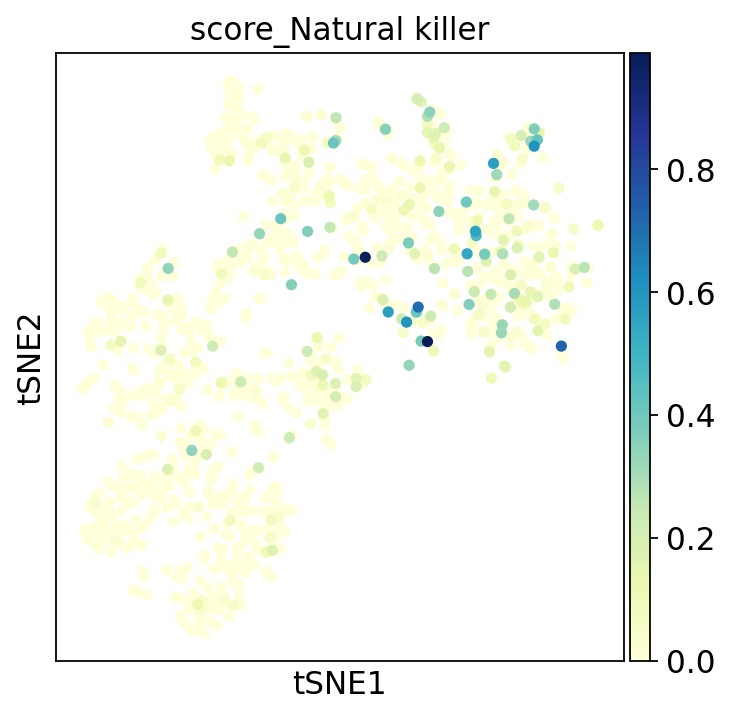

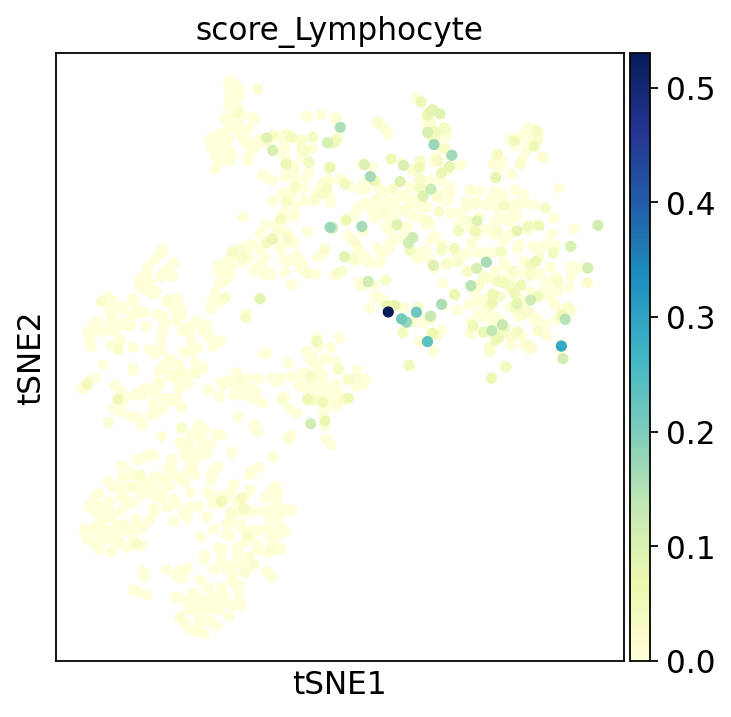

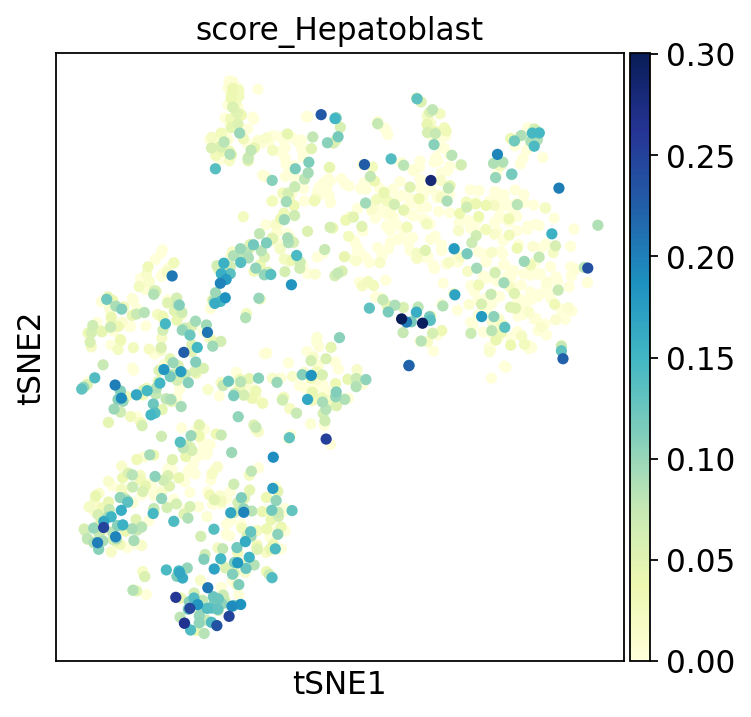

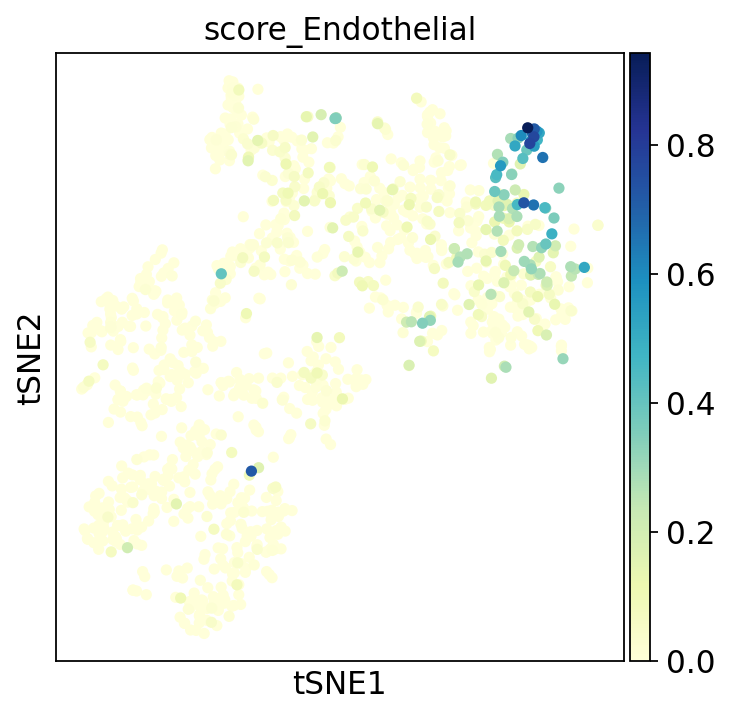

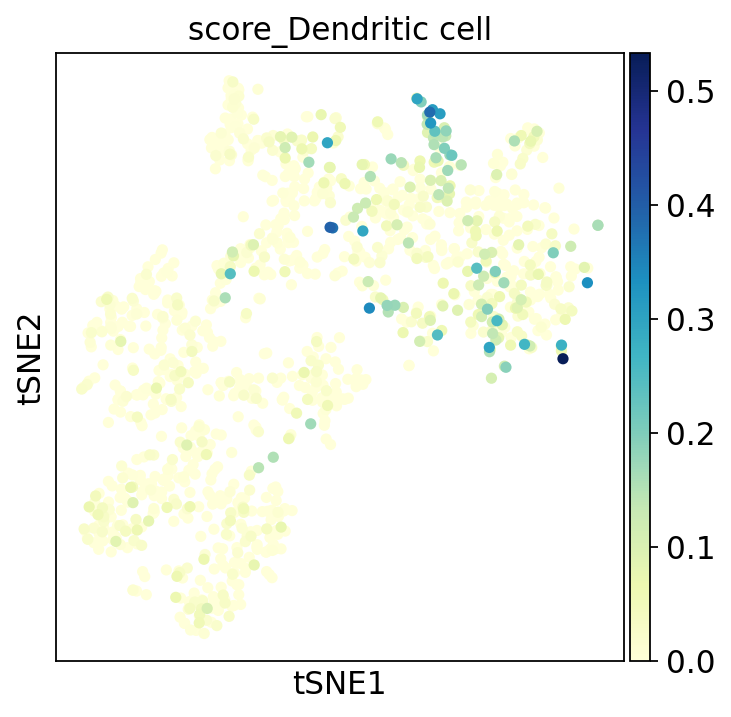

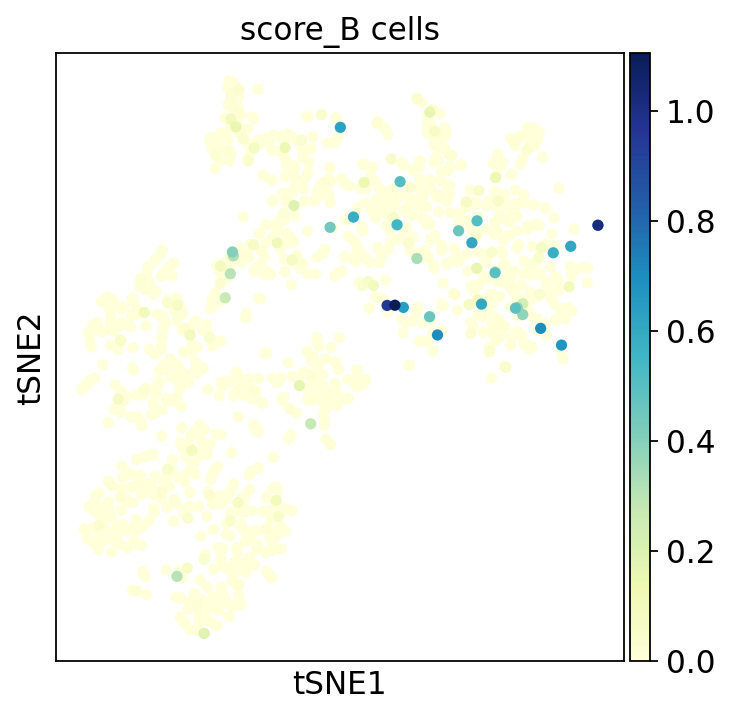

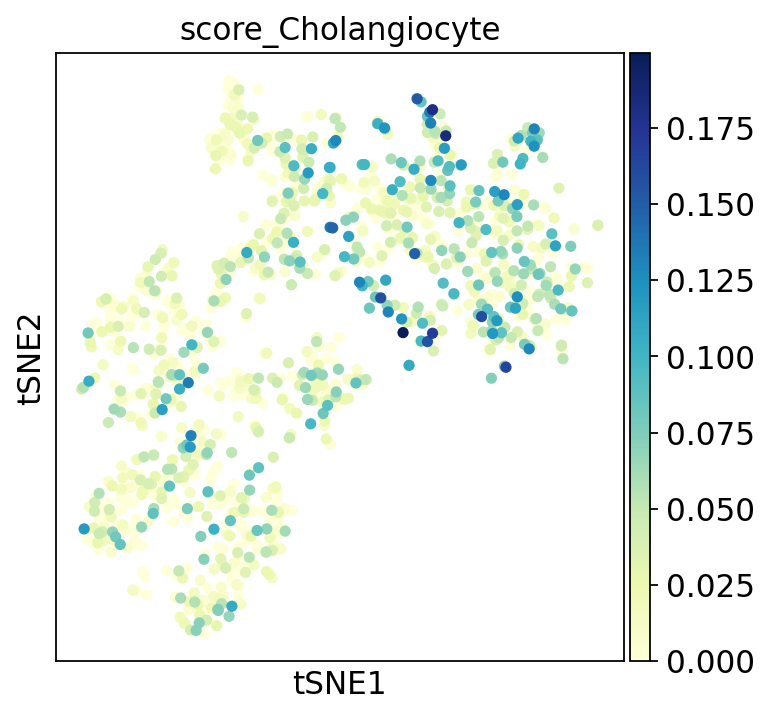

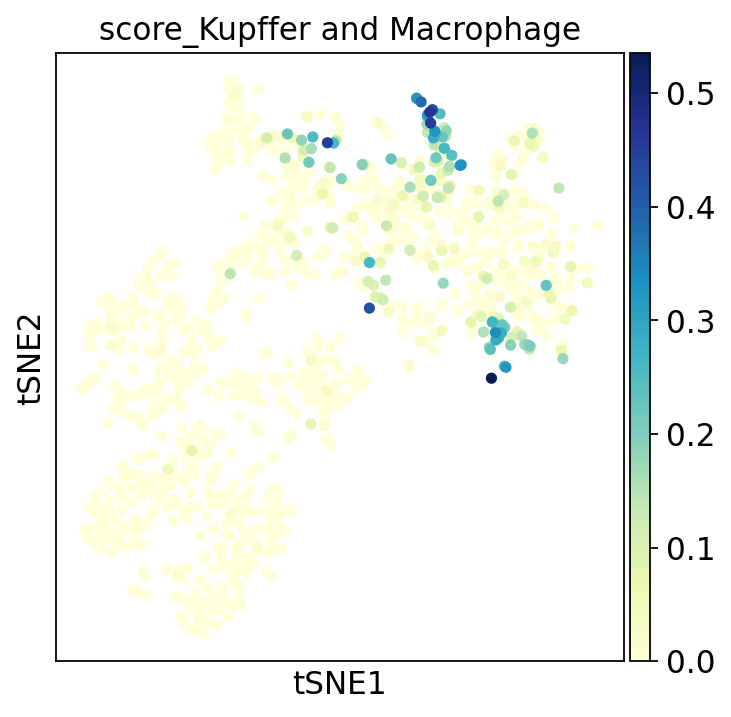

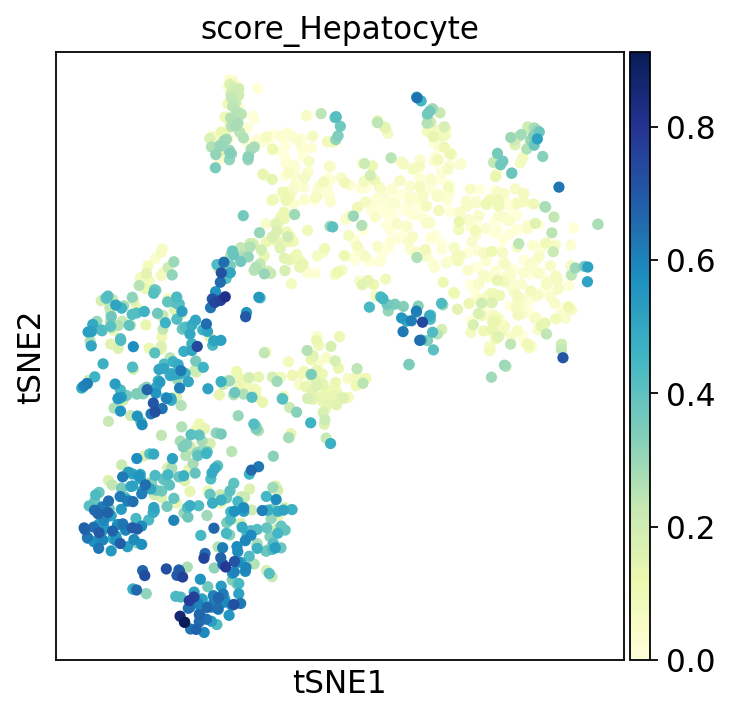

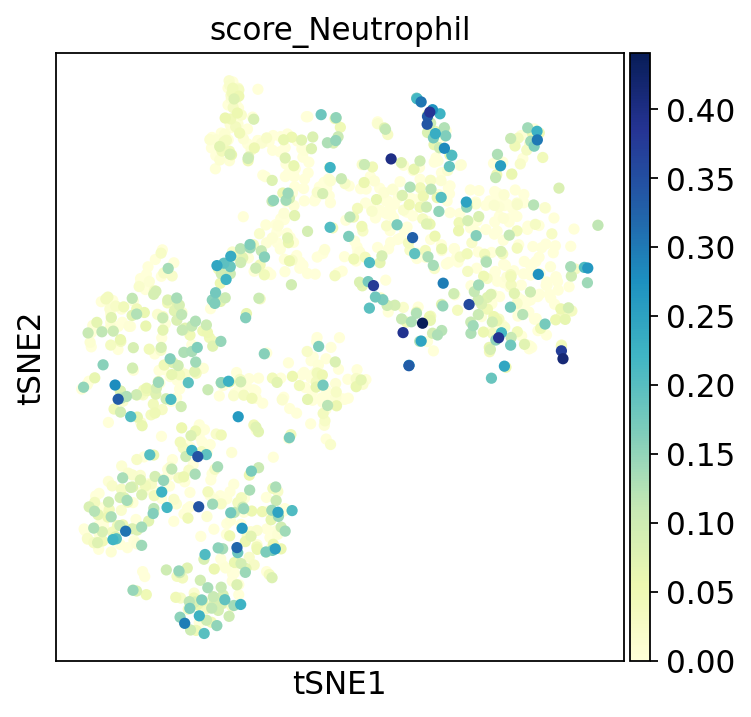

In [98]:
rcParams['figure.figsize']=(5,5)
for key in cell_type_id_dict.keys():
    sc.pl.tsne(adata_old, color='score_' + key, cmap='YlGnBu', vmin=0)

Subcluster non-hepatocytes.

In [99]:
rcParams['figure.figsize']=(5,5)
# high resolution clustering for the non-parenchymal cells
sc.tl.leiden(adata_old, resolution=2.5, key_added='leidenr02_02', restrict_to=['leiden_r02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['1,0']])
#sc.tl.louvain(adata, resolution=0.5, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0']])
#sc.tl.louvain(adata, resolution=0.75, key_added='louvainr02_02', restrict_to=['louvainr02_02', ['0,2']])

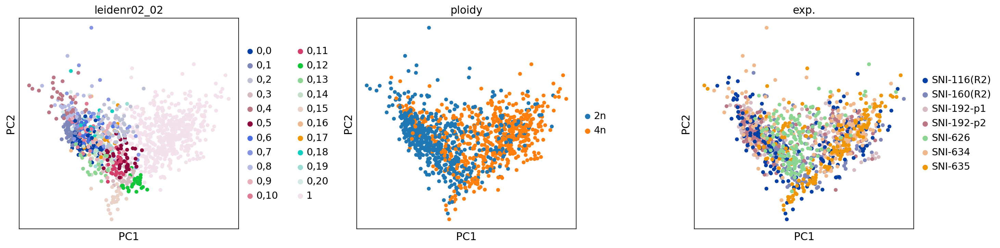

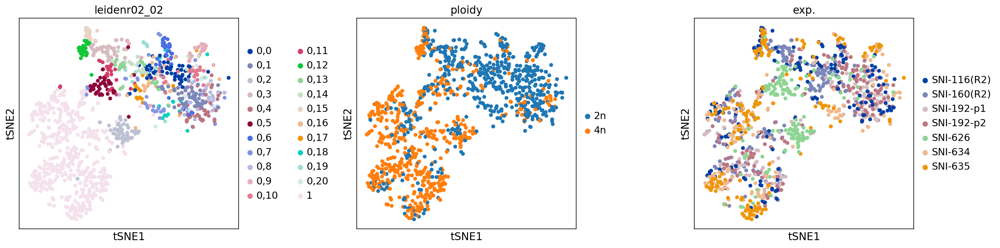

In [100]:
sc.pl.pca(adata_old, wspace=0.4, color=["leidenr02_02", "ploidy","exp."])
sc.pl.tsne(adata_old, wspace=0.4, color=["leidenr02_02", "ploidy","exp."])

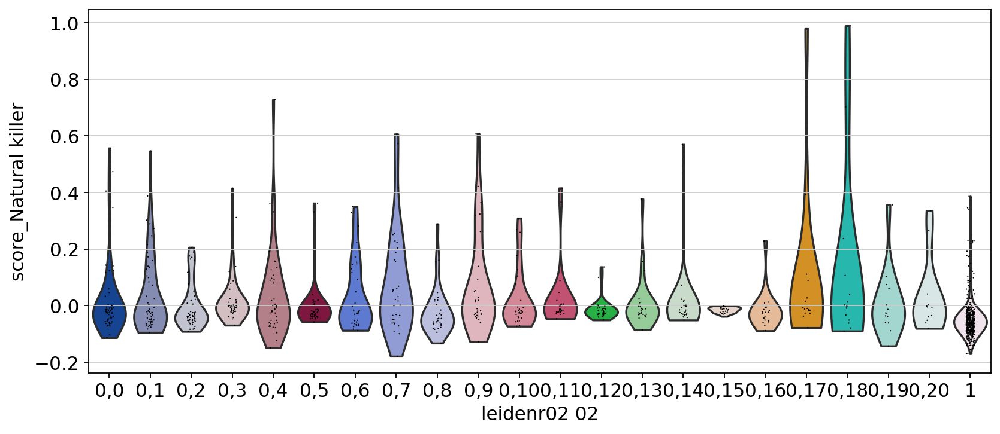

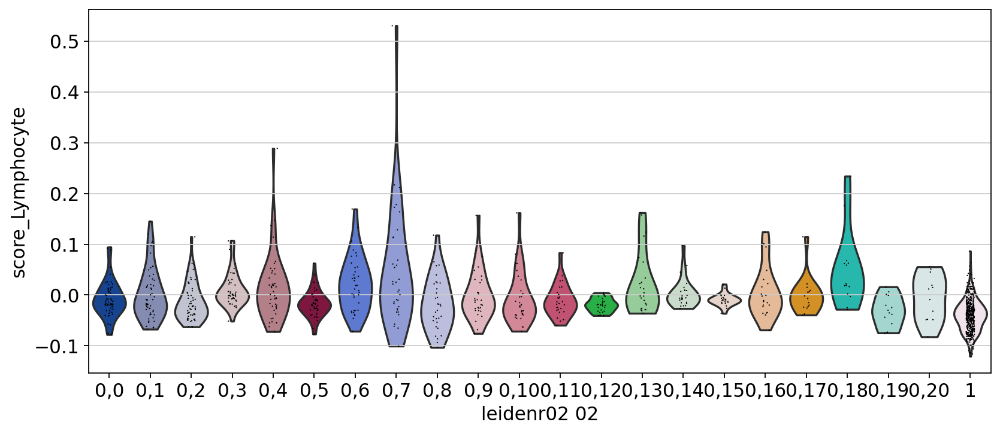

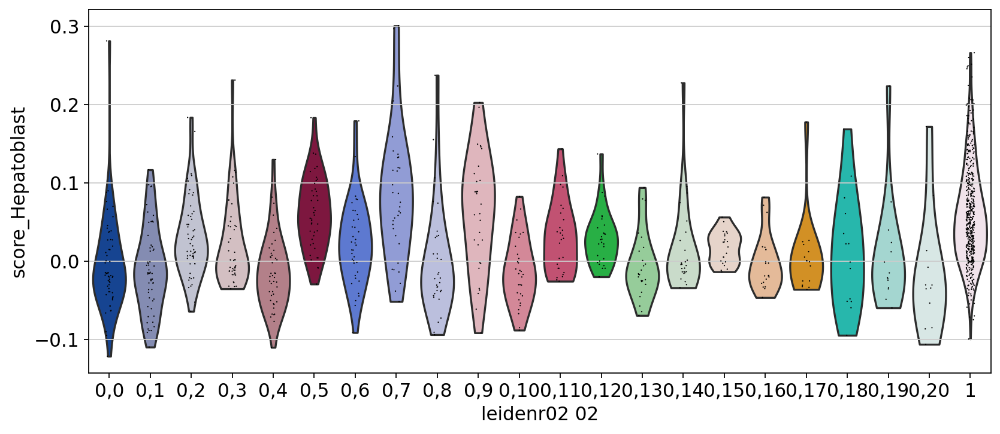

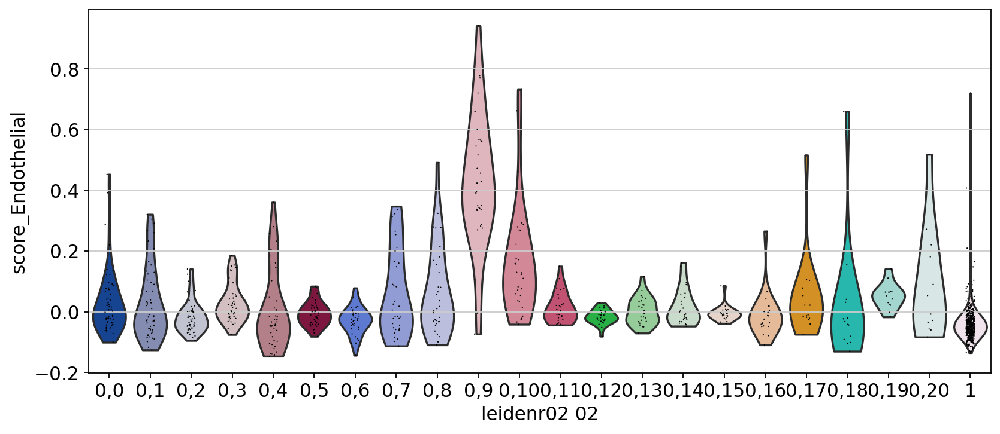

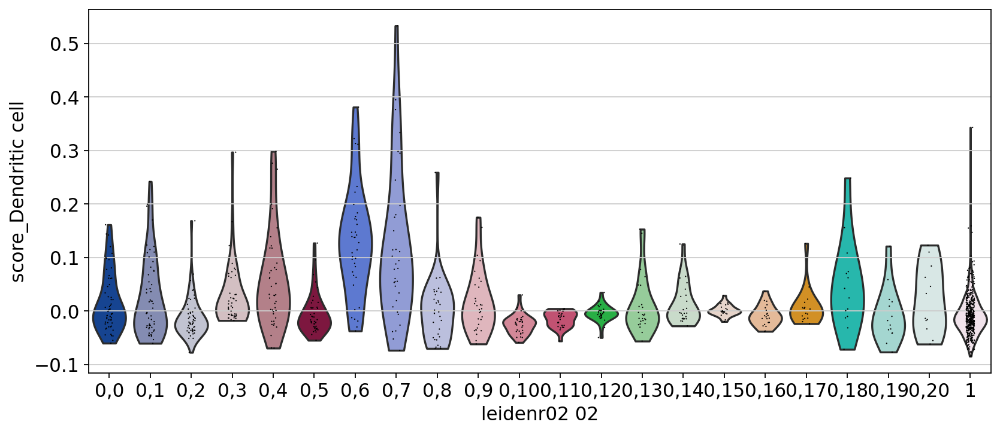

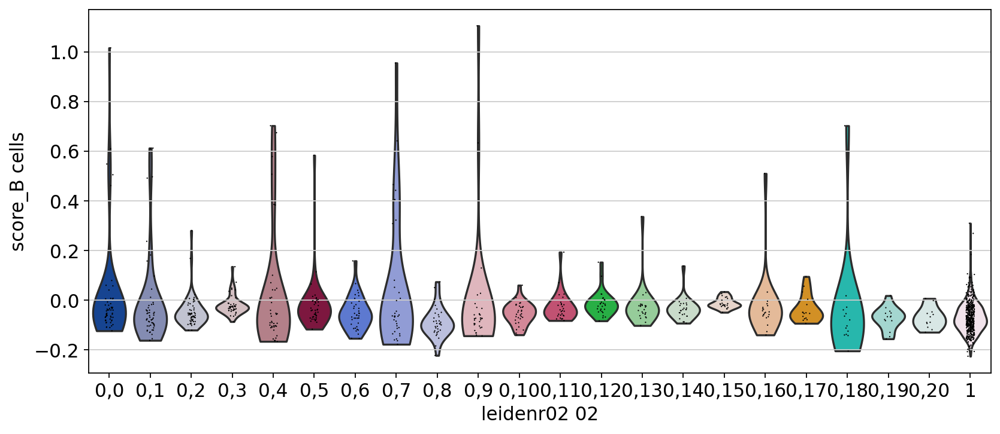

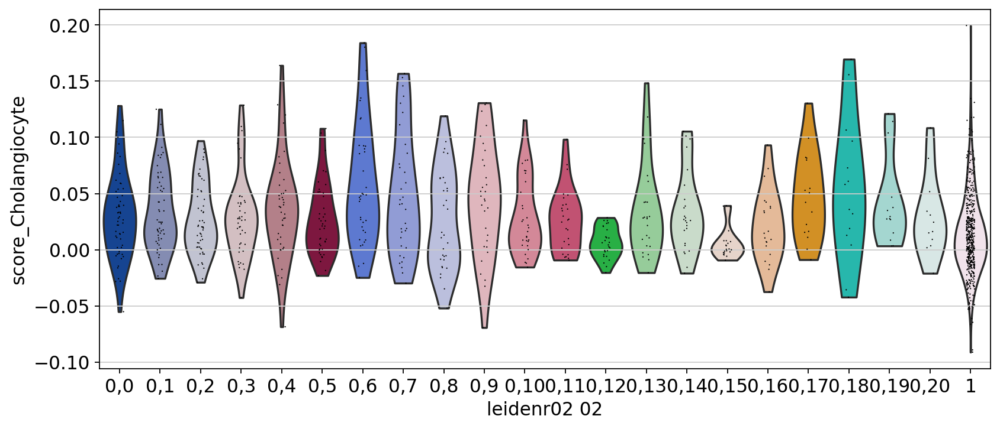

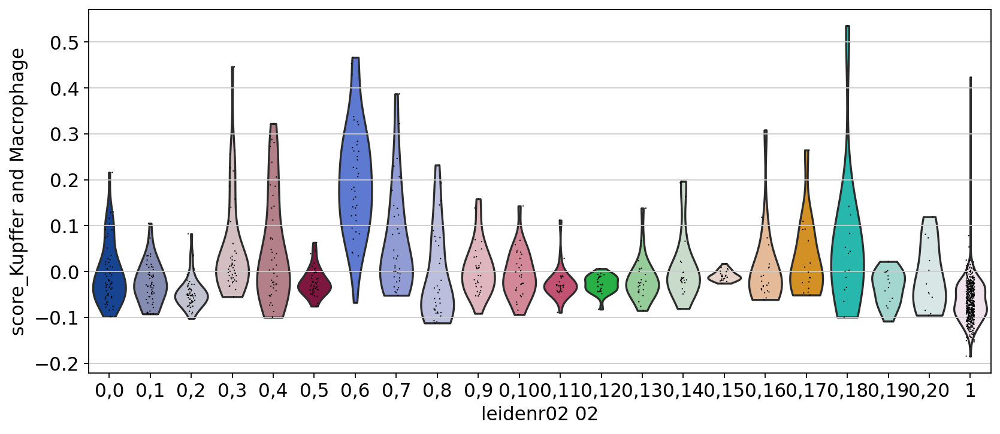

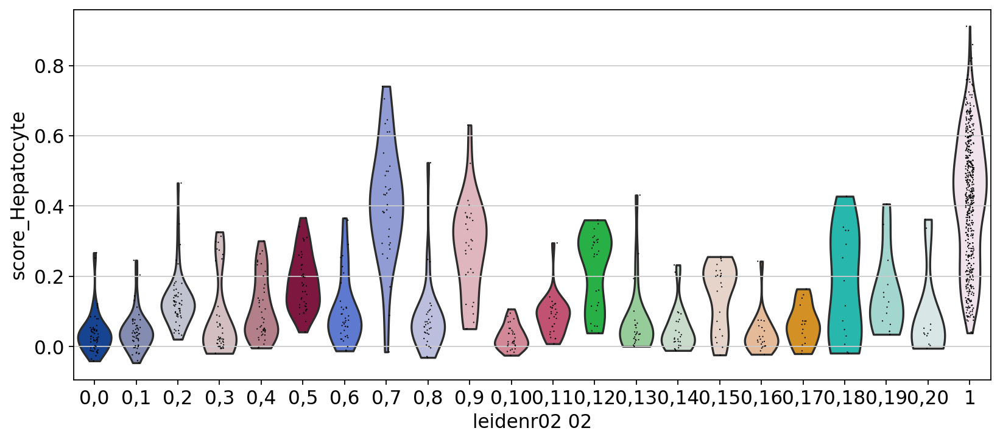

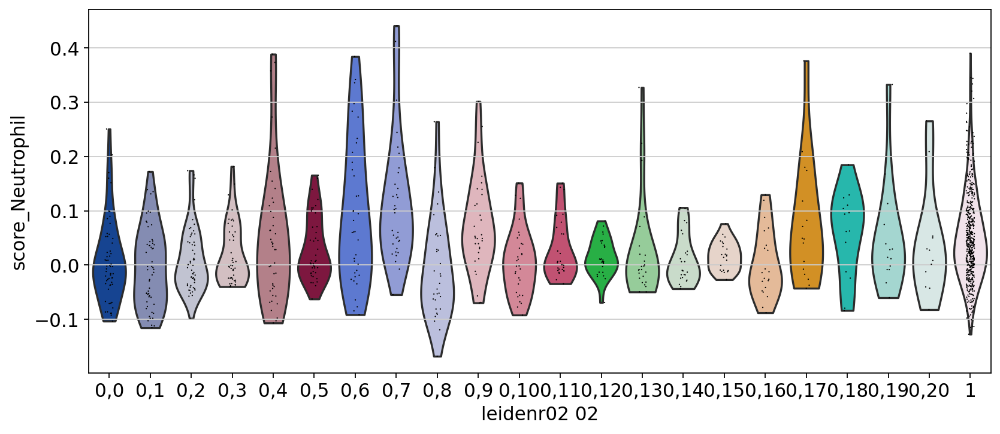

In [101]:
rcParams['figure.figsize']=(10,5)
for key in cell_type_id_dict.keys():
    sc.pl.violin(adata_old, keys='score_' + key, groupby='leidenr02_02')

Plot `Reln` and `Bach2` as Stellate Cell and T/B-cell marker, respectively.

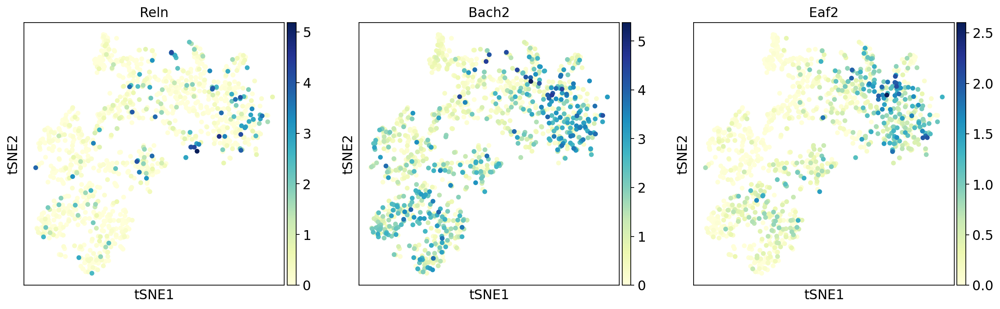

In [102]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, gene_symbols='gene_name', color=['Reln', 'Bach2', 'Eaf2'], cmap='YlGnBu')

Make a rough annotation.

In [105]:
adata_old.obs["cell_type"] = adata_old.obs["leidenr02_02"].cat.add_categories(['2n Hepatocytes', 
                                                     '4n Hepatocytes', 
                                                     'Hepatobiliary cells', 
                                                     'Endothelial cells',
                                                     'Kupffer and Dendritic cells', 
                                                      'Lymphocytes', 'Stellate cells'
                                                                       ])

adata_old.obs["cell_type"].loc[np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,7'])] = 'Hepatobiliary cells'
adata_old.obs["cell_type"].loc[np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,3', '0,6'])] = 'Kupffer and Dendritic cells'
adata_old.obs["cell_type"].loc[np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,13', '0,19'])] = 'Stellate cells' #based on Reln expression
adata_old.obs["cell_type"].loc[np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,0','0,1','0,4', '0,14','0,16', '0,17','0,18', '0,20'])] = 'Lymphocytes' #'Plasma B-cells'
adata_old.obs["cell_type"].loc[np.in1d(adata_old.obs["leidenr02_02"], 
                                         ['0,8','0,9', '0,10'])] = 'Endothelial cells'


adata_old.obs["cell_type"][np.logical_and(adata_old.obs["clusters"]=='2n_other_cluster',
                                          np.in1d(adata_old.obs['leidenr02_02'],['0,2', '0,5', '0,11', '0,12', '0,15'])
                                         )] = '2n Hepatocytes'
adata_old.obs["cell_type"][np.logical_and(adata_old.obs["clusters"]=='4n_other_cluster',
                                          np.in1d(adata_old.obs['leidenr02_02'],['0,2', '0,5', '0,11', '0,12', '0,15'])
                                         )] = '4n Hepatocytes'

adata_old.obs["cell_type"][adata_old.obs["clusters"]=='2n_hepatocytes'] = '2n Hepatocytes'
adata_old.obs["cell_type"][adata_old.obs["clusters"]=='4n_hepatocytes'] = '4n Hepatocytes'
adata_old.obs['cell_type'] = adata_old.obs['cell_type'].cat.remove_unused_categories() 


In [104]:
cell_compo_table(adata_old, 'prelim_anno', 'leidenr02_02')

prelim_anno,Hepatocytes,Hepatobiliary cells,Endothelial cells,Kupffer and Dendritic cells,Stellate cells,Plasma B-cells,B cells,T cells,All
leidenr02_02,,,,,,,,,
"0,0",0,0,0,0,0,0,4,53,57
"0,1",0,0,3,0,0,50,0,2,55
"0,2",23,0,6,0,0,0,26,0,55
"0,3",2,0,2,30,0,0,0,0,34
"0,4",0,0,3,0,0,1,0,39,43
"0,5",35,0,0,0,1,0,0,0,36
"0,6",0,0,0,36,0,0,0,1,37
"0,7",0,31,0,0,0,0,2,0,33
"0,8",0,0,31,0,0,1,0,0,32


In [106]:
cell_compo_table(adata_old, 'ploidy', 'leidenr02_02')

ploidy,2n,4n,All
leidenr02_02,,,
"0,0",54,3,57
"0,1",52,3,55
"0,2",19,36,55
"0,3",41,3,44
"0,4",34,9,43
"0,5",17,25,42
"0,6",30,7,37
"0,7",30,4,34
"0,8",17,15,32


In [107]:
adata_old.obs['cell_type'].value_counts()

4n Hepatocytes                 511
Lymphocytes                    243
2n Hepatocytes                 173
Endothelial cells               94
Kupffer and Dendritic cells     81
Stellate cells                  39
Hepatobiliary cells             34
Name: cell_type, dtype: int64

In [108]:
adata_old.obs['cell_type'].value_counts(normalize=True)

4n Hepatocytes                 0.434894
Lymphocytes                    0.206809
2n Hepatocytes                 0.147234
Endothelial cells              0.080000
Kupffer and Dendritic cells    0.068936
Stellate cells                 0.033191
Hepatobiliary cells            0.028936
Name: cell_type, dtype: float64

In [109]:
proportionas_old = pd.crosstab(adata_old.obs['cell_type'], adata_old.obs['strain'], normalize=1, margins=True)*100

In [110]:
proportionas_old

strain,C57Bl6/J,All
cell_type,,
2n Hepatocytes,14.723404,14.723404
4n Hepatocytes,43.489362,43.489362
Hepatobiliary cells,2.893617,2.893617
Endothelial cells,8.000000,8.000000
Kupffer and Dendritic cells,6.893617,6.893617
Lymphocytes,20.680851,20.680851
Stellate cells,3.319149,3.319149


In [111]:
proportionas_old.to_csv(data_dir + 'cell_counts_old_' + today + '.csv')

Color the clusters nicely

In [112]:
adata_old.uns["low_res_ct_colors"] = ["#686868", "#a9a9a9"]

In [113]:
adata_old.uns["cell_type_colors"] = ["#1f77b4", "#ff7f0e",
                                       #"#332288", "#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


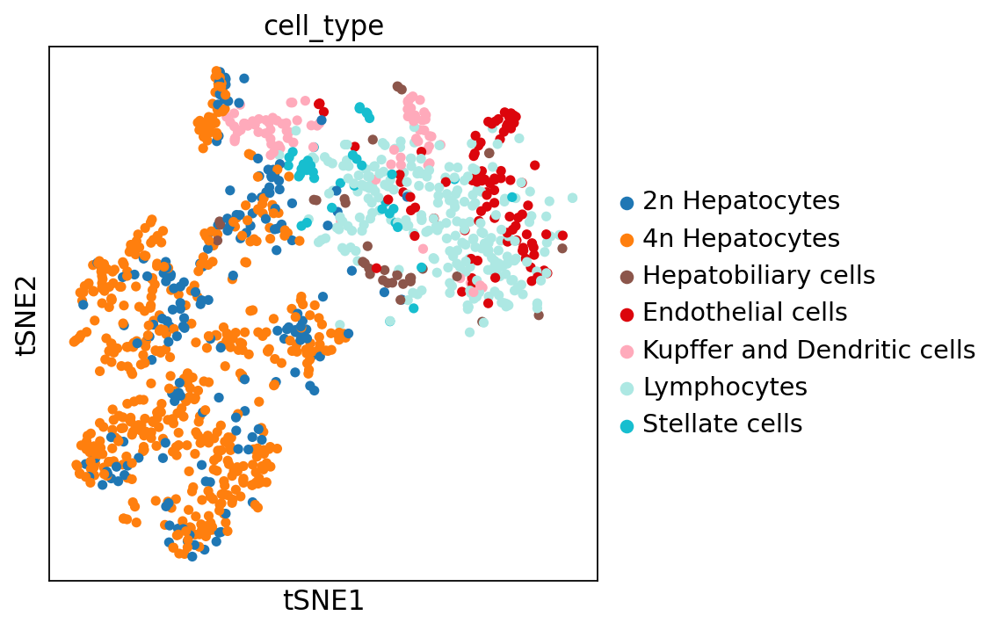

In [114]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, color="cell_type")

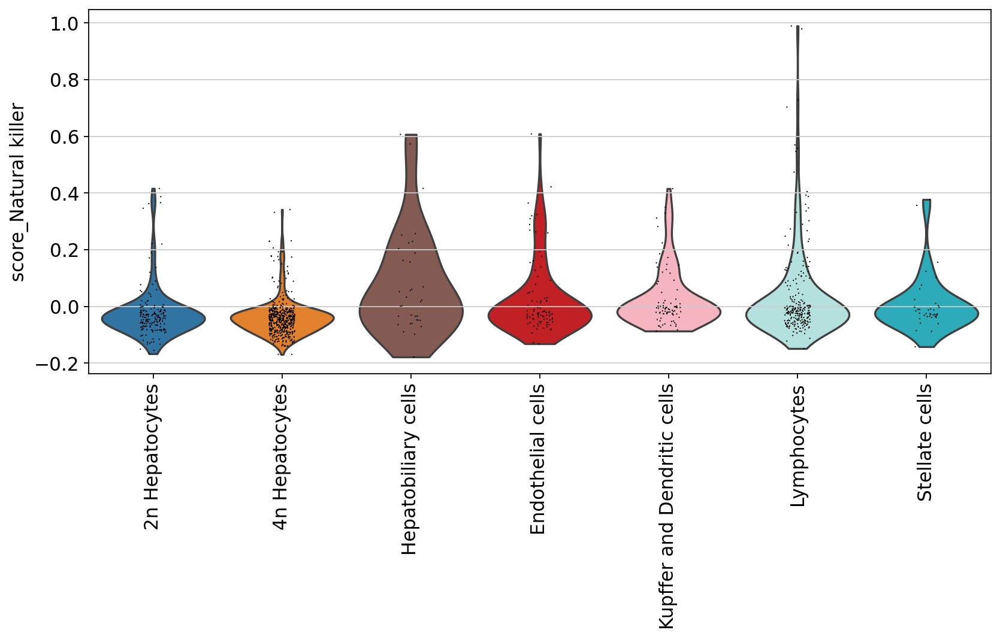

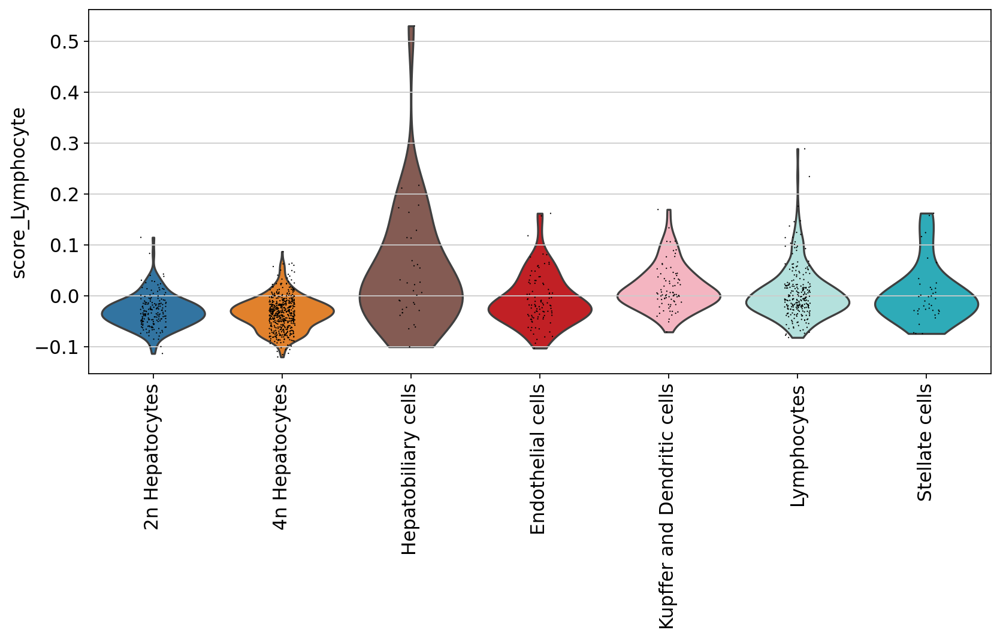

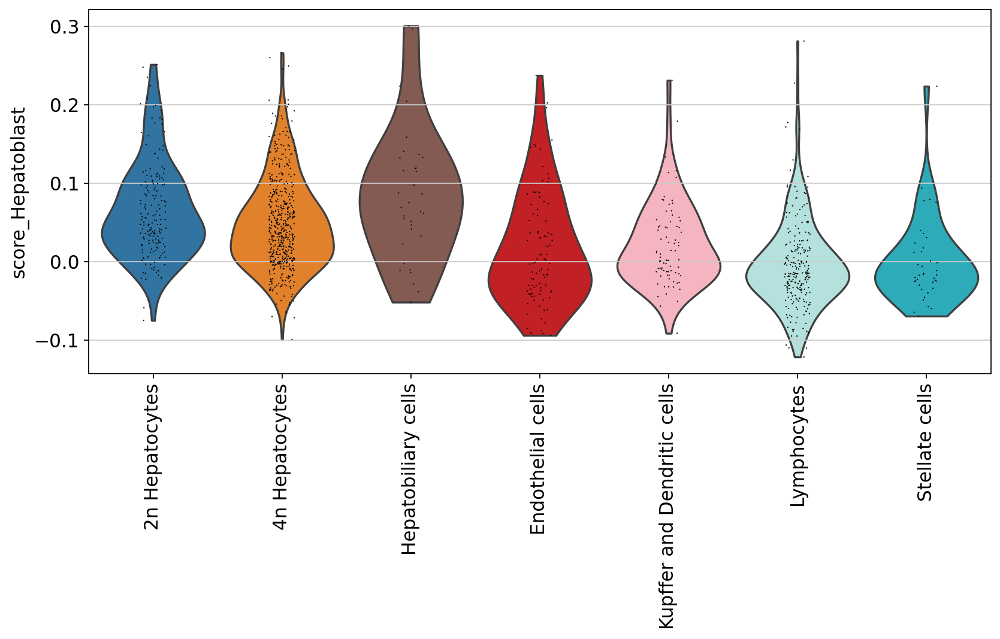

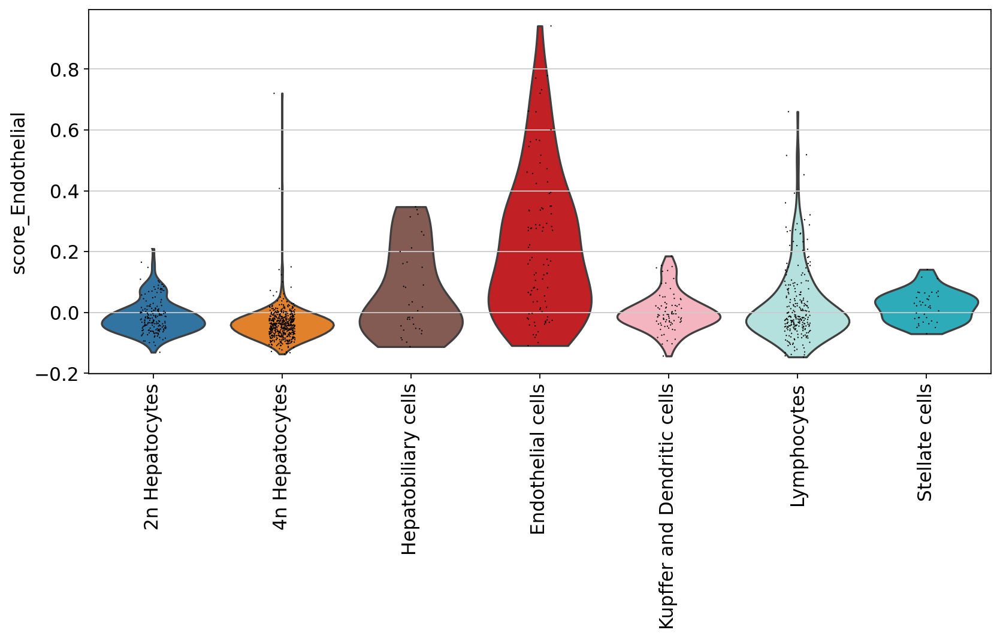

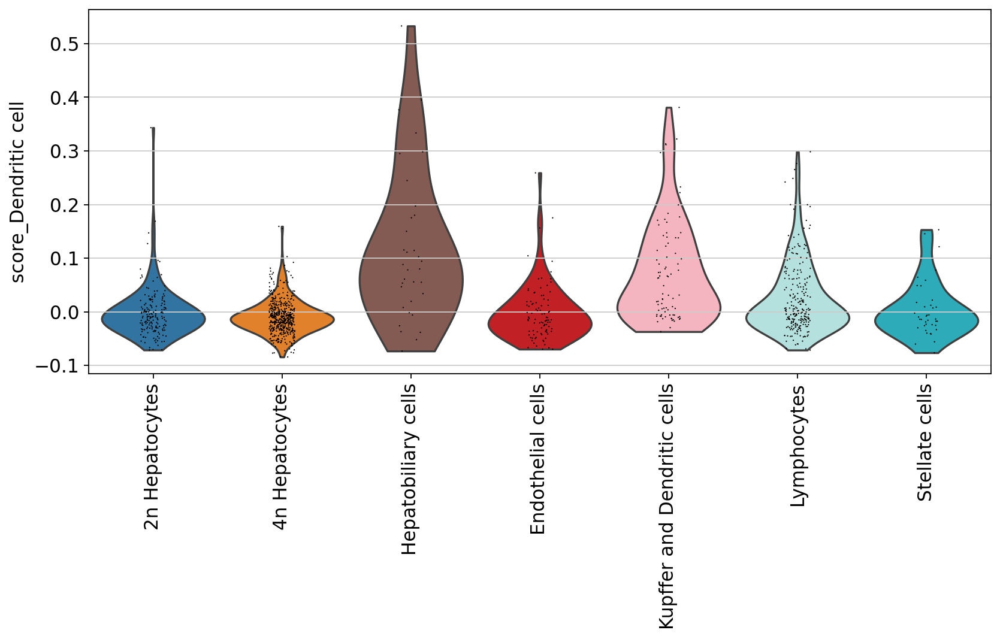

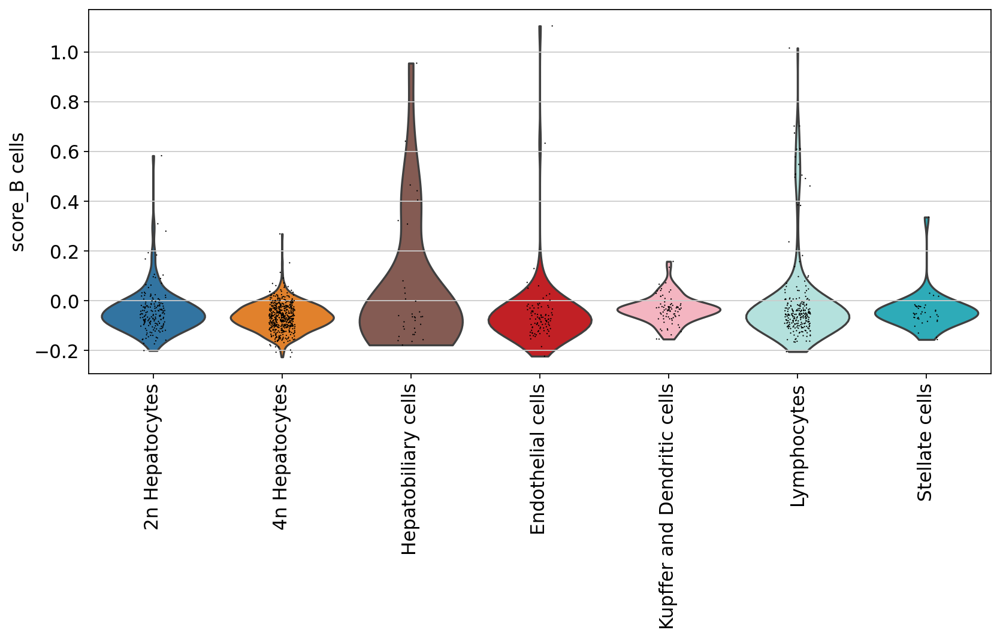

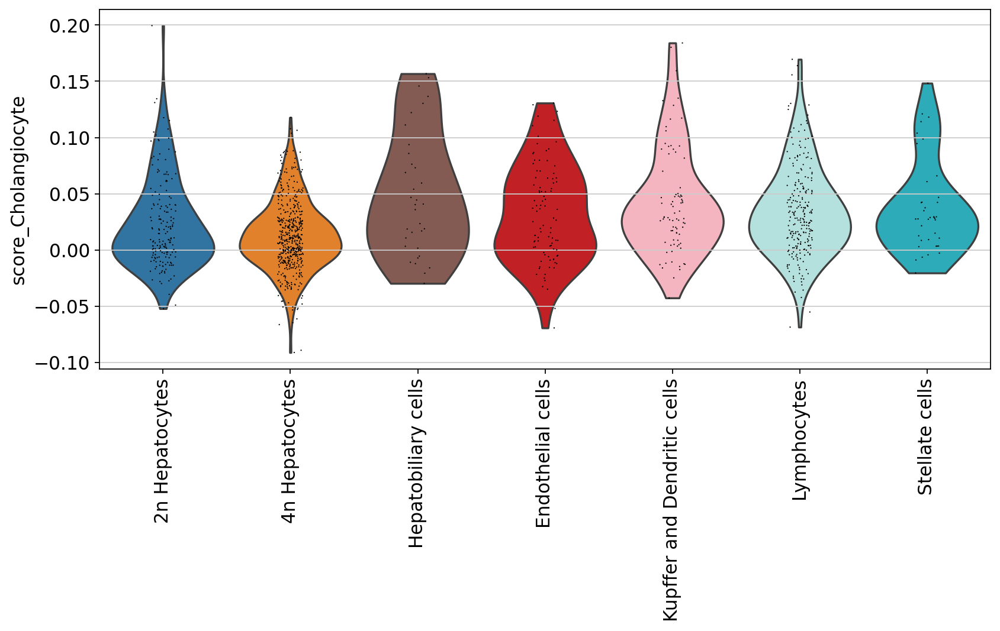

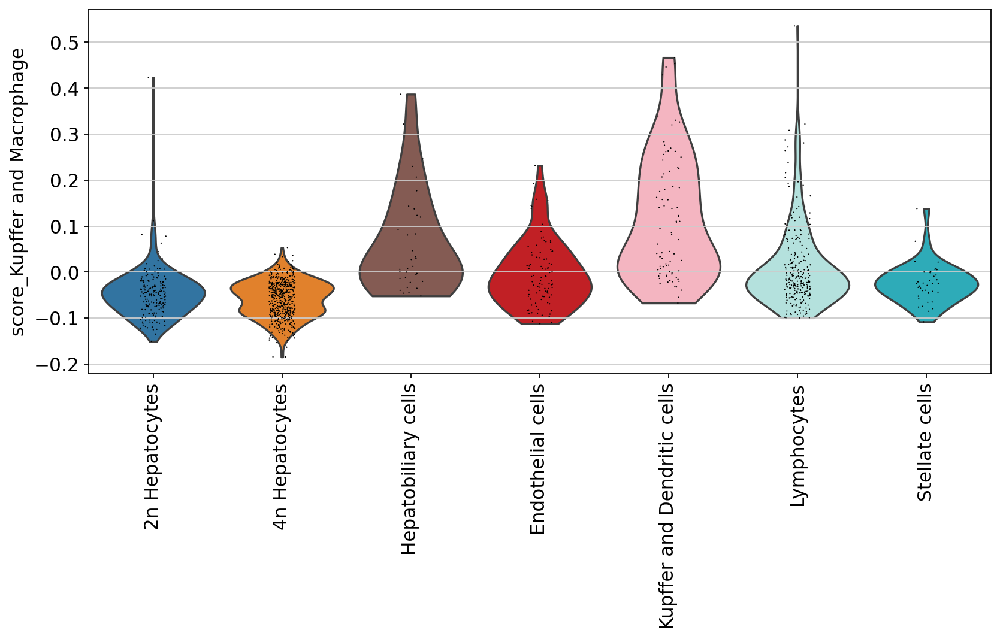

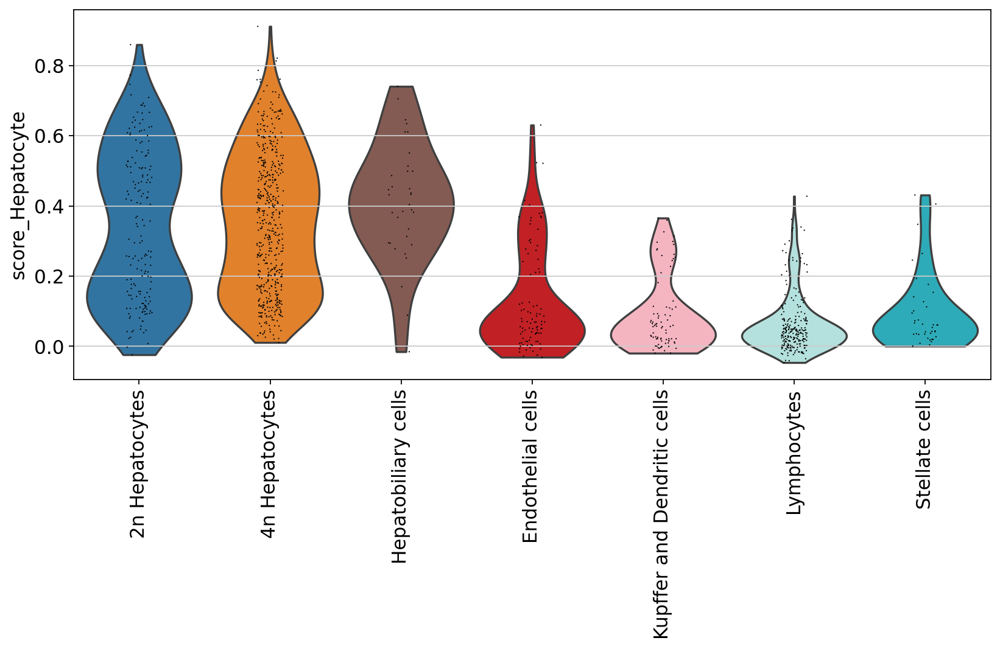

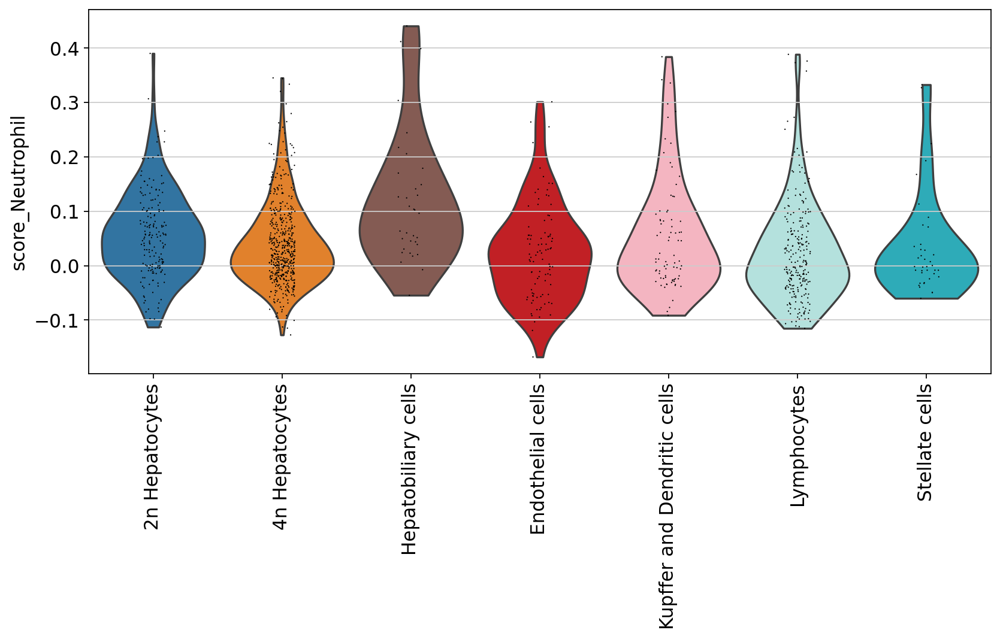

In [116]:
rcParams['figure.figsize']=(10,5)
for key in adata_old.obs.keys():
    if key.startswith('score_'):
        phase_key = key.split('_')[1] #do not show cell cycle scores
        if phase_key.startswith('G') or phase_key.startswith('S'):
            continue
        sc.pl.violin(adata_old, keys=key, groupby='cell_type', rotation=90)

In [117]:
chol_markers = ['Sptbn1','Sox9','Sox4','Kit','Slc22a3',
                'Hnf1b','Erbb3','Fgfr2','Fgfr3','Sorl1','Wwc1',
                'Cftr','Pkd2','Pkhd1l1','Lrp2','Cdh11','Igfbp5','Wt1','Igfbp6',
                'Wnt2b','Bmp4','Sulf2','Gas1','Gpc3','Vim','Fgf1','Onecut1',
                'Klra2','Ccl5','Pla2g7','Clec12a','Itgal','Folr2','Cybb','Cd38',
                'Epcam','Cdh1']

hepatoblast_markers = ["Ncam1","Cd44","Dlk1","Icam1","Epcam","Cdh1","Onecut3","Afp","Agt","Fgg",
                       "Gsta1","Id3","Lin28b","Etv5","Lgr5","Tbx3","Foxm1","Kit",
                      "Onecut1","Onecut2","Notch2","Tbx3","Hnf1b","Hes1","Foxa2","Foxa3","Hhex",
                       "Sall4","Hnf4a","Alb","Krt19","Epcam","Tacstd2","Anpep","Itga6","Cd133",
                       "Thy1","Fgf7","Sox9","Krt18","Krt19","Cebpa","Serpina16","Mki67","Krt7",
                       "Tmem45b","Tacstd2","Igdcc4","Itga6","Ptprcap","Atxn1"]

nmarker_name = {}
nmarker_id = []
index = 0
for n in adata_old.var["gene_name"].tolist():
    if n in hepatoblast_markers:
        nmarker_name[n] = adata_old.var_names[index]
        nmarker_id.append(adata_old.var_names[index])
    index += 1

adatah = adata_old[:,nmarker_id].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [118]:
adata_old.obs["hblast_marker_sum"] = np.sum(adatah.layers["raw"], axis=1)

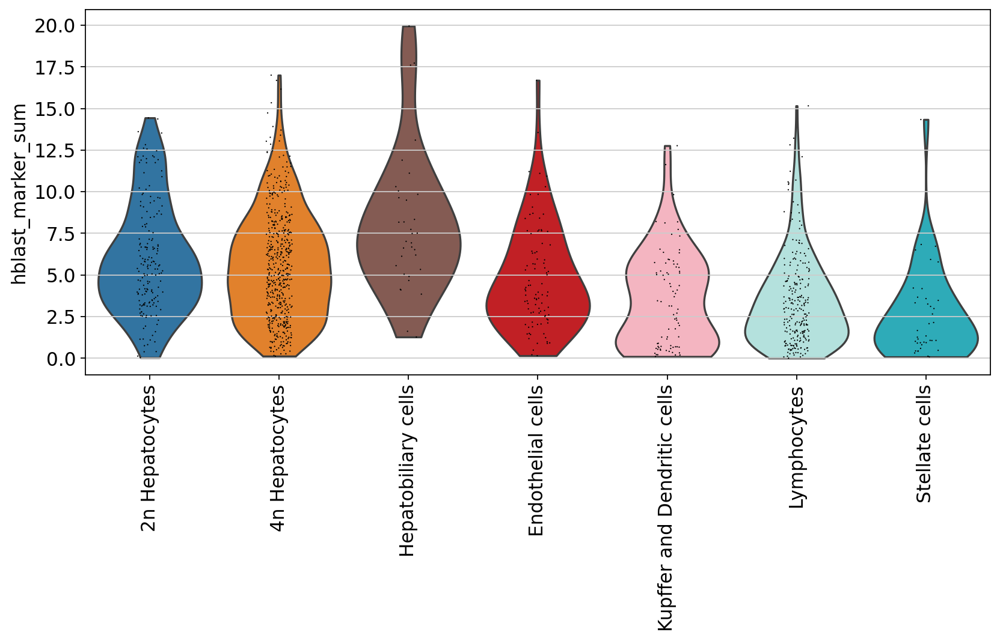

In [119]:
rcParams['figure.figsize']=(10,5)
sc.pl.violin(adata_old, "hblast_marker_sum", groupby="cell_type", rotation=90)

Combine the hepatocytes and re-arrange the levels.

In [120]:
adata_old.obs['cell_type1'] = adata_old.obs['cell_type'].cat.add_categories(['Hepatocytes'])
adata_old.obs['cell_type1'][np.in1d(adata_old.obs['cell_type'], ["2n Hepatocytes", "4n Hepatocytes"])] = 'Hepatocytes'
adata_old.obs['cell_type1'] = adata_old.obs['cell_type1'].cat.remove_unused_categories()
adata_old.obs['cell_type1'] = adata_old.obs['cell_type1'].cat.reorder_categories(['Hepatocytes', 
                                              'Hepatobiliary cells', 'Endothelial cells', 
                                     "Kupffer and Dendritic cells", 'Lymphocytes','Stellate cells',
                                   
                                                                         ])

In [121]:
adata_old.uns["cell_type1_colors"] = ["#332288", #Hepatocyte color
                                       "#8c564b",
                                       "#DC050C","#FFAABB","#ade8e3","#17becf"]

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


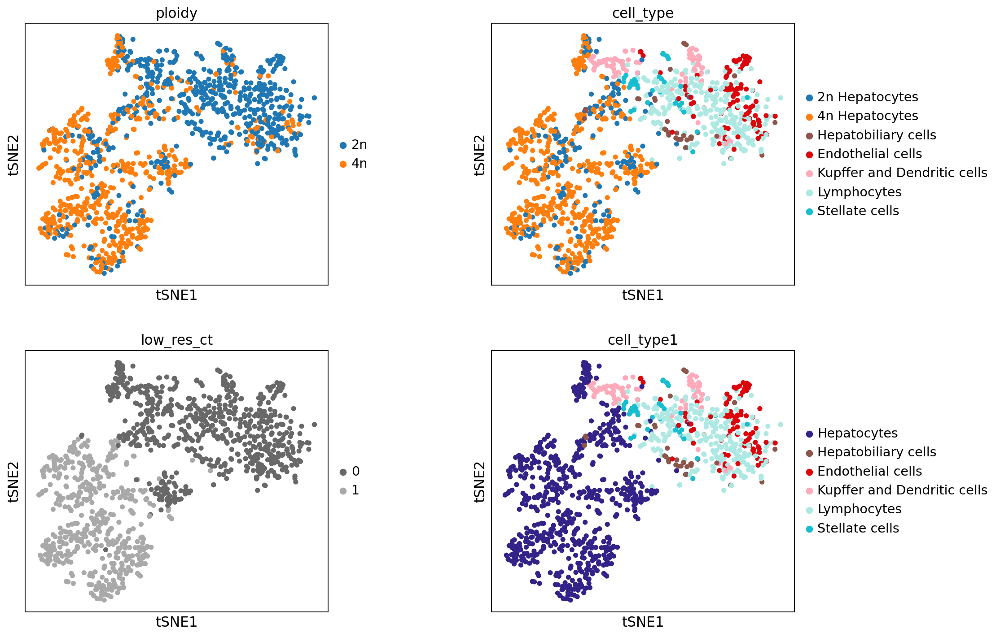

In [123]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_old, color=["ploidy", "cell_type","low_res_ct", "cell_type1"],
           ncols=2, wspace=0.4, save='_'+today +"_old_prelim_annotation.pdf")

Save the annotated adata

In [124]:
adata_old.write(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


In [14]:
adata_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

In [15]:
# plotting the markers nicely (using scanpy 1.6)
small_marker_dict = {"Hepatocytes":["Cyp27a1","Ppara","Pck1"],
                    "Hepatobiliary cells":["Lgr5","Id3","Fgg"],
                    "Endothelial cells":["Dnase1l3","Ptprb","Stab2", "Clec4g", "Flt1","Gpihbp1"],
                    "Kupffer and Dendritic cells":["Clec4f","Slc40a1","Cd5l", "Adgre1",  
                                                   "Cd68", "Cd163", "Vsig4", "H2-Aa"],
                    "Lymphocytes":["Bcl2","Syk","Lck", 'Lsp1'],
                     "Neutrophils":["Csf3r", "Retnlg"],
                     'Stellate cells': ['Reln'],
                    "B cells": ["Cd79a", "Bank1", "Igkc", 'Eaf2'],
                     "T cells": ["Bach2"],
                    "NK cells": ["Clec1b", "Klrb1c", "Nkg7"]}

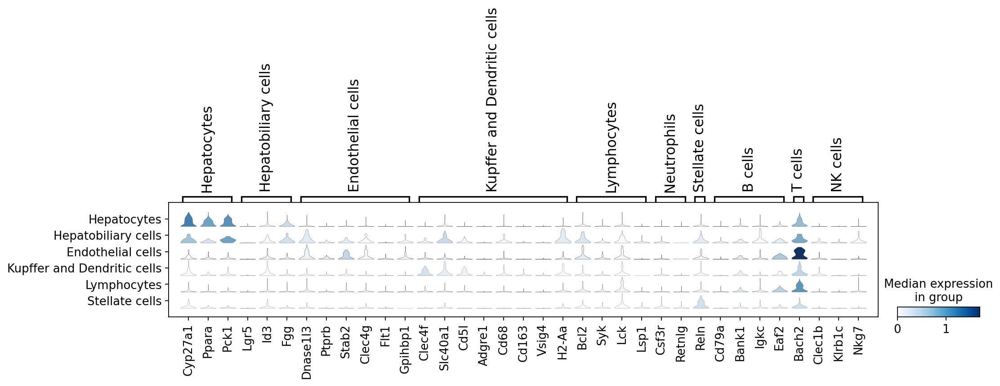

In [17]:
ax = sc.pl.stacked_violin(adata_old, gene_symbols="gene_name", groupby="cell_type1", 
                     var_names=small_marker_dict, save='_' + today + "_old_prelim_annotation_markers.pdf")

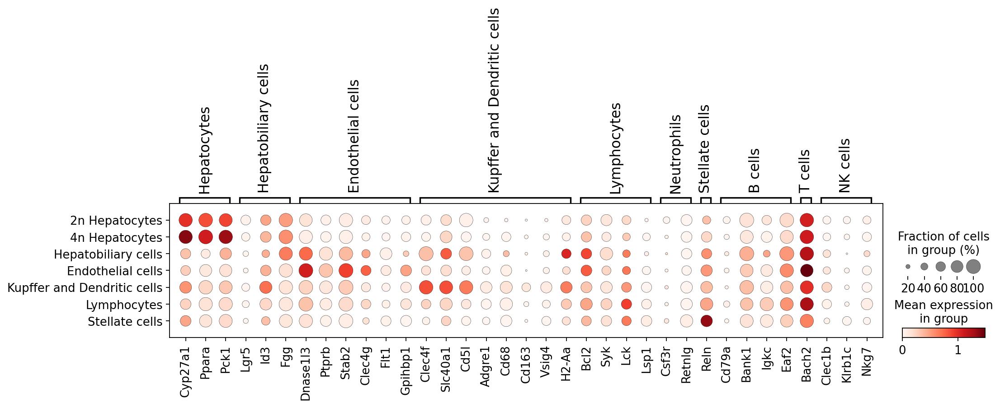

In [18]:
sc.pl.dotplot(adata_old, gene_symbols="gene_name", groupby="cell_type", vmin=0,
              var_names=small_marker_dict, use_raw=False, save='_' + today + "_old_prelim_annotation_markers.pdf")   

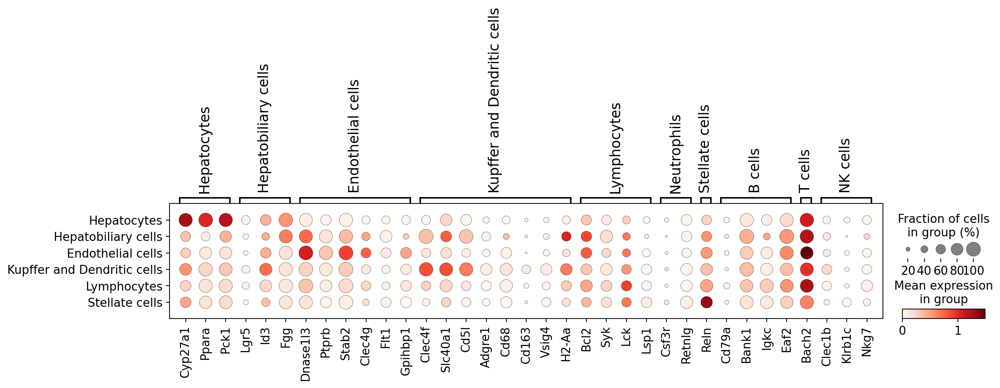

In [19]:
sc.pl.dotplot(adata_old, gene_symbols="gene_name", groupby="cell_type1", vmin=0,
              var_names=small_marker_dict, use_raw=False, save='_' + today + "_old_prelim_annotation_markers2.pdf")   

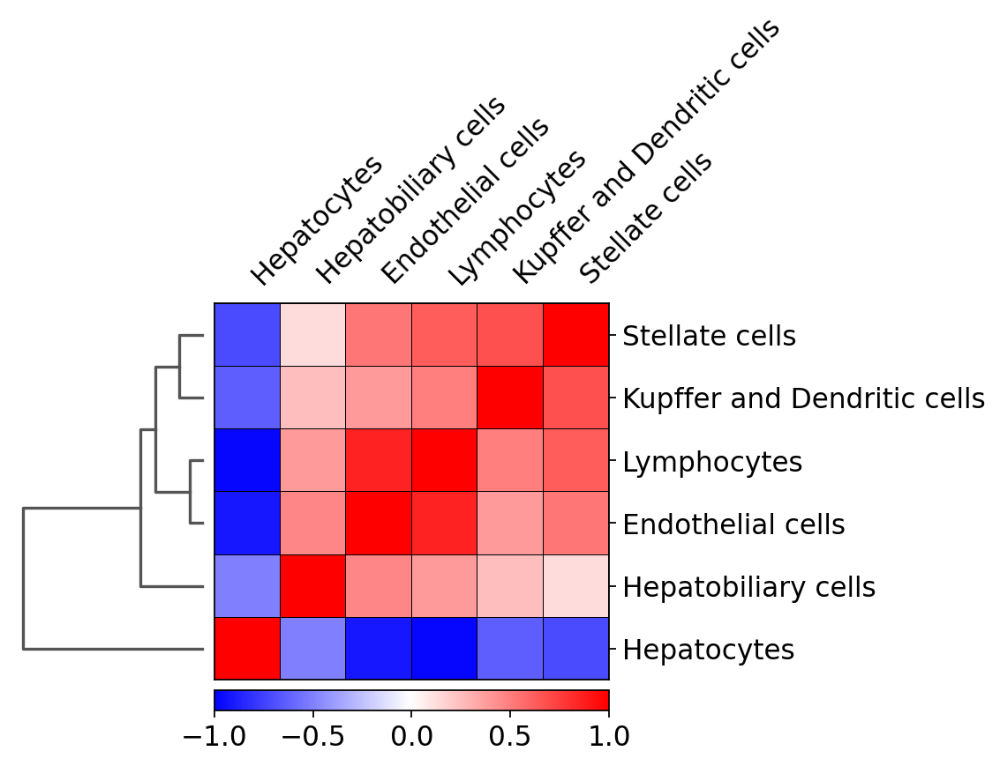

In [20]:
sc.pl.correlation_matrix(adata_old, groupby="cell_type1", save='_' + today + 'old_correlation.pdf')

Change gene names from ENSEMBL ID to gene symbol.

In [125]:
adata_old.var_names = adata_old.var['gene_name'].astype('str')

In [126]:
adata_old.var_names_make_unique()

In [127]:
adata_old

AnnData object with n_obs × n_vars = 1175 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'prelim_anno', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Natural killer', 'score_Lymphocyte', 'score_Hepatoblast', 'score_Endothelial', 'score_Dendritic cell', 'score_B cells', 'score_Cholangiocyte', 'score_Kupffer and Macrophage', 'score_Hepatocyte', 'score_Neutrophil', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1'
    var: 'length', 'gene_name', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns: 'ERCC.dilution

In [128]:
del adata_old.layers['counts']
del adata_old.layers['norm_counts']
del adata_old.layers['raw']
del adata_old.layers['raw_bin']

In [129]:
del adata_old.var['gene_name']

## Cell type proportions

Here, we combine the annotation results of old and young mice and compute the relative proportions per cell type.

In [130]:
meta_all = pd.concat([adata_old.obs, adata_young.obs])

In [131]:
meta_all.shape

(2908, 52)

In [132]:
meta_info = meta_all[['age_grouped','ploidy', 'cell_type1']]
meta_info['cell_count'] = 'cell_count'

<ipython-input-132-f81c580c24a7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  meta_info['cell_count'] = 'cell_count'


In [133]:
tmp = meta_info.groupby(['ploidy','age_grouped', 'cell_type1', 'cell_count'])['ploidy'].count().unstack()

In [134]:

tmp = tmp.rename(columns=str).reset_index()

In [135]:
tmp2 = tmp.groupby(['age_grouped']).transform(lambda x: x *100/ x.sum())

In [136]:
tmp2[['ploidy', 'age_grouped', 'cell_type1']] = tmp[['ploidy', 'age_grouped', 'cell_type1']]

In [137]:
tmp2.to_csv(data_dir + 'cell_type_proportions_separate_annotation_wt_' + today + '.csv')

In [138]:
tmp.to_csv(data_dir + 'cell_type_total_count_separate_annotation_wt_' + today + '.csv')

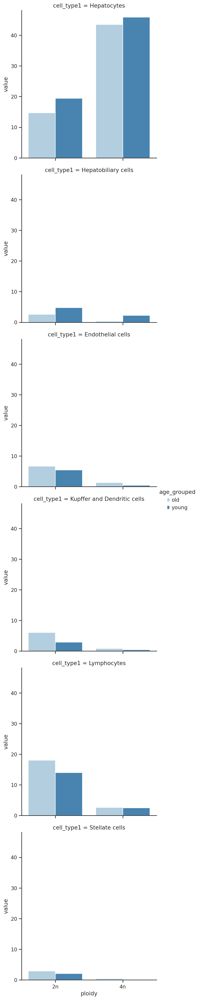

In [139]:
#fig, ax = plt.subplots(figsize=(12,5))
df = pd.melt(tmp2, id_vars=['ploidy','age_grouped','cell_type1'], value_vars='cell_count')
sns.set_context('notebook')
sns.set_style('ticks')
#d = sns.FacetGrid(df, col='cell_type1',
#                  row="strain")
d =sns.catplot(x='ploidy', y = 'value', hue="age_grouped", row = 'cell_type1',
          data=df, palette='Blues', kind='bar')
#d.set_ylabel('Relative proportion')
#loc, labels = plt.xticks()
#d.set_xticklabels(labels, rotation=90)
#d.set_xlabel('Cell type')
plt.savefig('./figures/' + today + '_cell_proportions_separate_annotation_wt.pdf')
plt.show()

### Prepare cellxgene browser

I want to have the `t-SNE` plots of both datasets separated, so I'll add 100 to all values of the `t-SNE` in the old data (1st axis).

In [140]:
adata_tmp = adata_old.copy()

In [141]:
adata_tmp.obsm['X_emb'] = adata_tmp.obsm['X_tsne']

In [142]:
for idx in np.arange(adata_old.n_obs):
    adata_tmp.obsm['X_emb'][idx][0] = 100 + adata_old.obsm['X_tsne'][idx][0]

In [143]:
adata_tmp.obsm['X_emb']

array([[ 97.68910736,  17.0820327 ],
       [ 97.94637138,  18.37299548],
       [ 89.63551022,  18.04611069],
       ...,
       [ 98.05555187,   8.05017849],
       [ 93.46739634,   7.1166277 ],
       [102.19311149,  -2.97129469]])

In [144]:
adata_young.obsm['X_emb'] = adata_young.obsm['X_tsne']

In [145]:
adata_tmp0 = adata_young.concatenate(adata_tmp, index_unique=None)

In [146]:
adata_tmp2 = adata[adata.obs['strain']=='C57Bl6/J'].copy()

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Change gene names from ENSEMBL ID to gene symbol.

In [147]:
adata_tmp2.var_names = adata_tmp2.var['gene_name'].astype('str')

In [148]:
adata_tmp2.var_names_make_unique()

In [149]:
adata_logTPM_tmp = ann.AnnData(X = adata_tmp0.raw.X, var = adata_tmp2.var, obs= adata_tmp0.obs)
adata_logTPM_tmp.obsm = adata_tmp0.obsm
adata_logTPM_tmp.var_names = adata_tmp2.var_names
adata_logTPM_tmp.obs['cell_type'] = adata_tmp0.obs['cell_type']
adata_logTPM_tmp.obs['cell_type1'] = adata_tmp0.obs['cell_type1']

In [156]:
adata_logTPM_tmp.uns['cell_type_colors'] = adata_old.uns['cell_type_colors']
adata_logTPM_tmp.uns['cell_type1_colors'] = adata_old.uns['cell_type1_colors']

In [150]:
del adata_logTPM_tmp.var['gene_name']

In [152]:
age_ploidy = [adata_logTPM_tmp.obs['ploidy'][idx] + '_' + 
                     adata_logTPM_tmp.obs['age_grouped'][idx]  for idx in range(adata_logTPM_tmp.n_obs)]

In [153]:
adata_logTPM_tmp.obs['ploidy_age'] = age_ploidy

/home/icb/maren.buettner/anaconda3/envs/sc-tutorial/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'exp.' as categorical
... storing 'age' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'leidenr02_02' as categorical
... storing 'ploidy_age' as categorical


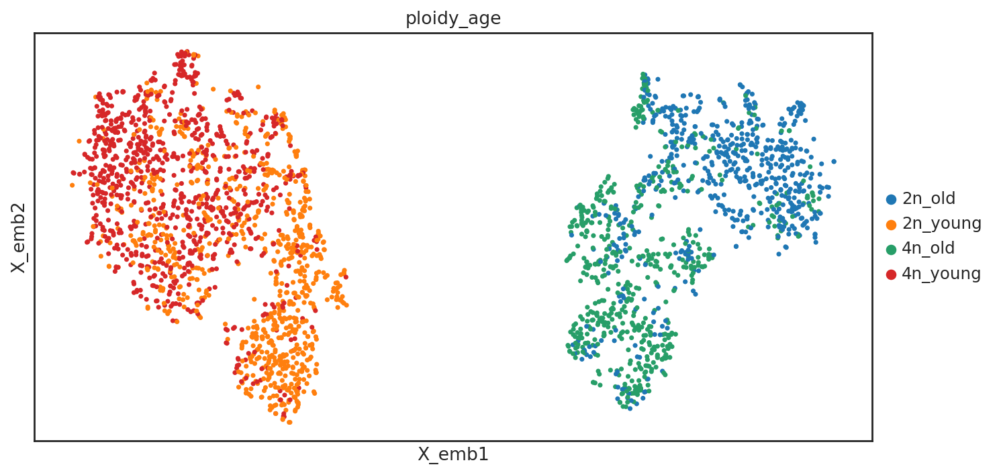

In [154]:
rcParams['figure.figsize']=(10,5)
sc.pl.embedding(adata_logTPM_tmp, color='ploidy_age', basis='X_emb')

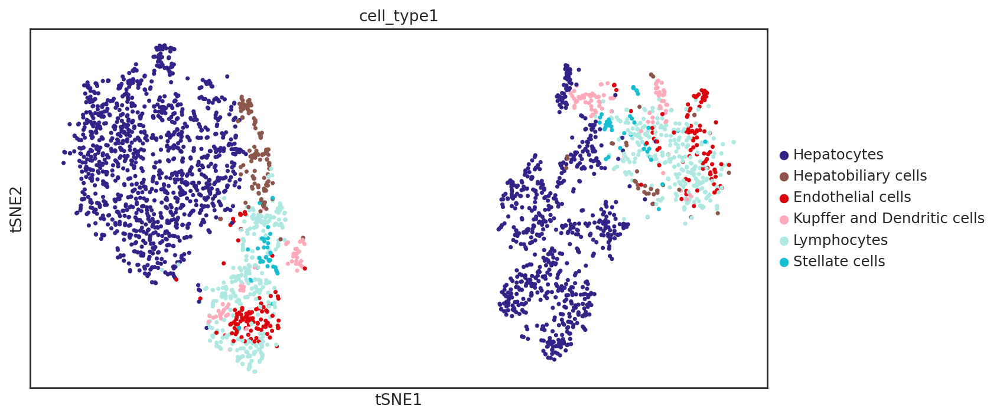

In [157]:
sc.pl.tsne(adata_logTPM_tmp, color='cell_type1')

In [158]:
adata_logTPM_tmp.write(data_dir + 'cellxgene_wt.h5ad')
